<center> <img src="https://media.springernature.com/lw685/springer-static/image/chp%3A10.1007%2F978-3-030-39364-9_5/MediaObjects/489541_1_En_5_Fig3_HTML.png" width=50% > </center>

<br><br>

<center> 
    <font size="6">Lab 2: Neighborhood Processing, Low-level Filters & Applications in image processing</font> 
</center>
<center> 
    <font size="4">Computer Vision 1 University of Amsterdam</font> 
</center>
<center> 
    <font size="4">Due 23:59, September 19, 2025 (Amsterdam time)</font> 
</center>
</center>

<br><br>

***

<br><br>

<center>

Student1 ID: 14633485 \
Student1 Name: David van Batenburg

Student2 ID: 16195965\
Student2 Name: Samuele Punzo

Student3 ID: 16334523 \
Student3 Name: Edoardo Vergnano

Student4 ID: 16217632 \
Student4 Name: Seyedeh Zahra Ahmadi

</center>

### **Import Libraries**

In [1]:
import sys

if sys.version_info[0] < 3:
    raise Exception("Python 3 or a more recent version is required.")

In [2]:
# environment and libraries
import os
import math
import numpy as np
import time
import cv2
import matplotlib
import matplotlib.pyplot as plt
import sklearn
import scipy.signal
import pandas as pd
from tqdm import tqdm

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

In [3]:
# Make sure you're using the provided environment!
assert cv2.__version__ == "4.10.0", "You're not using the provided Python environment!"
assert np.__version__ == "1.26.4", "You're not using the provided Python environment!"
assert matplotlib.__version__ == "3.9.2", "You're not using the provided Python environment!"
# Proceed to the next cell if you don't get any error.

### **Instructions**

Your code and discussion must be handed in this jupyter notebook, renamed to **StudentID1_StudentID2_StudentID3.ipynb** before the deadline by submitting it to the Canvas Lab 2 Assignment. Please also fill out your names and ID's above.

For full credit, make sure your notebook follows these guidelines:
- It is mandatory to **use the Python environment provided** with the assignment; the environment specifies the package versions that have to be used to prevent the use of particular functions. Using different packages versions may lead to grade deduction. In the Python cell above you can check whether your environment is set up correctly.
- To install the environment with the right package versions, use the following command in your terminal: ```conda env create --file=CV1_environment.yaml```, then activate the environment using the command ```conda activate cv1```.
- Do not use additional packages or materials that have not been provided or explicitly mentioned.
- Please express your thoughts **concisely**. The number of words does not necessarily correlate with how well you understand the concepts.
- Answer all given questions and sub-questions.
- Try to understand the problem as much as you can. When answering a question, give evidences (qualitative and/or quantitative results, references to papers, figures etc.) to support your arguments. Note that not everything might be explicitly asked for and you are expected to think about what might strengthen you arguments and make the notebook self-contained and complete.
- Tables and figures must be accompanied by a **brief** description. Do not forget to add a number, a title, and if applicable name and unit of variables in a table, name and unit of axes and legends in a figure.

__Note:__ A more complete overview of the lab requirements can be found in the Course Manual on Canvas

Late submissions are not allowed. Assignments that are submitted after the strict deadline will not be graded. In case of submission conflicts, TAs’ system clock is taken as reference. We strongly recommend submitting well in advance, to avoid last minute system failure issues.

Plagiarism note: Keep in mind that plagiarism (submitted materials which are not your work) is a serious crime and any misconduct shall be punished with the university regulations. This includes the use of generative tools such as ChatGPT.

**ENSURE THAT YOU SAVE ALL RESULTS / ANSWERS ON THE QUESTIONS (EVEN IF YOU RE-USE SOME CODE).**

### **Overview**

- [Section 1: Neighborhood Processing for Image Processing (3 points)](#section-1)
  - [Question 1 (2 points)](#question-1)
  - [Question 2 (1 points)](#question-2)
- [Section 2: Low-Level Gaussian Filters (11 points)](#section-2)
  - [Question 3 (2 points)](#question-3)
  - [Question 4 (3 points)](#question-4)
  - [Question 5 (1 point)](#question-5)
  - [Question 6 (2 points)](#question-6)
  - [Question 7 (1 point)](#question-7)
  - [Question 8 (2 points)](#question-8)
- [Section 3: Low-Level Gabors Filters (15 points)](#section-3)
  - [Question 9 (6 points)](#question-9)
  - [Question 10 (1 point)](#question-10)
  - [Question 11 (1 point)](#question-11)
  - [Question 12 (1 point)](#question-12)
  - [Question 13 (6 points)](#question-13)
- [Section 4: Noise in digital images (27 points)](#section-4)
  - [Question 14 (2 points)](#question-14)
  - [Question 15 (4 points)](#question-15)
  - [Question 16 (1 point)](#question-16)
  - [Question 17 (1 point)](#question-17)
  - [Question 18 (3 points)](#question-18)
  - [Question 19 (2 points)](#question-19)
  - [Question 20 (2 points)](#question-20)
  - [Question 21 (3 points)](#question-21)
  - [Question 22 (2 points)](#question-22)
  - [Question 23 (2 points)](#question-23)
  - [Question 24 (3 points)](#question-24)
  - [Question 25 (2 points)](#question-24)
- [Section 5: Edge Detection (20 points)](#section-5)
  - [Question 26 (4 points)](#question-26)
  - [Question 27 (3 points)](#question-27)
  - [Question 28 (4 point)](#question-28)
  - [Question 29 (1 points)](#question-29)
  - [Question 30 (2 points)](#question-30)
  - [Question 31 (2 points)](#question-31)
  - [Question 32 (2 points)](#question-32)
  - [Question 33 (2 points)](#question-33)
- [Section 6: Foreground-background separation (24 points)](#section-6)
  - [Question 33 (8 points)](#question-33)
  - [Question 34 (8 points)](#question-34)
  - [Question 35 (4 points)](#question-35)
  - [Question 36 (4 points)](#question-36)
- [Section X: Individual Contribution Report (Mandatory)](#section-x)

<a id="section-1"></a>
### **Section 1: Neighborhood Processing for Image Processing**

This assignment will start with an exploration of neighborhood processing techniques, which are fundamental to image processing. These techniques allow for the extraction of structural patterns such as edges and blobs, and are extensively used in tasks like image denoising and segmentation. Neighborhood or block processing is also a key component of Convolutional Neural Networks.

Neighborhood processing involves examining the pixels surrounding a point $I(x, y)$ in an image $I$ and applying a function, $h(k, l)$, that measures specific properties or relationships within that local window. This function, $h(k, l)$, is known as the neighborhood operator or local operator, and is often implemented as a linear filter.

Linear filters compute a weighted sum of the neighboring pixel intensities and assign this sum to the pixel of interest, producing the output $I_{out}(i, j)$. These filters are typically represented as square matrices. Terms like filters, kernels, weight matrices, or masks are often used interchangeably in the literature. A kernel is a matrix that defines a neighborhood operation, such as edge detection or smoothing.

Linear filters are applied across the entire image using operators like correlation ($\otimes$) and convolution ($\ast$).\

Both operators are *linear shift-invariant* (LSI), meaning they function consistently across the image. The discrete forms of these operators are expressed as follows:

- **Correlation (1)**:

$\mathbf{I}_{out} = I \otimes  \mathbf{h} \\
\mathbf{I}_{out}(i,j) = \sum_{k,l}  \mathbf{I}(i+k,j+l) \mathbf{h}(k,l)$

- **Convolution (2)**:

$\mathbf{I}_{out} = \mathbf{I} \ast  \mathbf{h} \\
\mathbf{I}_{out}(i,j) = \sum_{k,l} \mathbf{I}(i-k,j-l) \mathbf{h}(k,l)$

The following example illustrates neighborhood processing: a kernel or mask convolves over the input image, with each pixel intensity multiplied by the corresponding weight in the kernel. The example uses a $3x3$ averaging mask, showing the effect of filtering on the input image.

<div>
<img src="https://assets.8thlight.com/images/insights/posts/2022-03-25-what-is-a-convolution/padding_example.png" width="700"/>
</div>

<a id="question-1"></a>
#### <font color='#FF0000'>Question 1 (2 points)</font>

What is the difference between correlation and convolution operators? How do they treat the signals $\mathbf{I}$ and $\mathbf{h}$?

##### <font color='yellow'>Answer:</font>

The correlation and convolution operators are two linear operators used in image filtering. Correlation measures the similarity between two signals, while convolution measure the impact of a signal on the other one. The difference between them is represented by how they make use of the kernel in the dot product that calculates the value of each pixel of the output image.

On one hand, the correlation operator takes the kernel as it is, it slides its center over the image from left to right and top to bottom, and applies the dot product to obtain the corresponding output pixel's value.

On the other hand, the convolution operator flips the kernel in both dimensions (top to bottom, left to right), and then applies the correlation filtering like described above.

These two operators take signals $I$ and $h$ and, like mentioned above, calculate the pixels' values of the output signal $I_{out}$ through a weighted sum of the neighboring pixels' intensities, where the weights are defined by the values of the kernel's cells.

Source: _"Correlation vs Convolution Filtering" by A. Yalçiner, September 2019_

<a id="question-2"></a>
#### <font color='#FF0000'>Question 2 (1 point)</font>

Correlation and convolution operators are equivalent when we make an assumption on the form of the mask $\mathbf{h}$. Can you identify the case? Give precise answer here.

##### <font color='yellow'>Answer:</font>

They are equivalent whenener the mask $\mathbf{h}$ has the following form: $\mathbf{h(k, l) = h(-k, -l)}$ _for every (k, l) in h_

<a id="section-2"></a>
### **Section 2: Low-Level Gaussian Filters**

In this section, you will design common linear filters used in neighborhood processing. We will focus in on Gaussian filters, which are widely used for image smoothing and noise reduction.

<a id="question-3"></a>
#### <font color='#FF0000'>Question 3 (2 points)</font>

The 1D Gaussian filter is defined as follows:

$G_{\sigma}(x)=\frac{1}{\sigma\sqrt{2\pi}}\text{ exp}(-\frac{x^2}{2\sigma^2})$

where $\sigma$ is the standard deviation of the Gaussian. However, such a formulation creates an infinitely large convolution kernel. In practice, the kernel is truncated with a `kernel_size` parameter such that $-\left\lfloor \frac{kernel\_size}{2}\right\rfloor \leq x \leq \left\lfloor \frac{kernel\_size}{2} \right\rfloor$, where $\left\lfloor \cdot \right\rfloor$ is the floor operator. For example, if `kernel_size` equals 3, then $x \in \{ -1, 0, 1 \}$.

Now, implement the following function `gaussian_kernel_1D`.

**Hint:** Do not forget to normalize your filter.

**Note:** You are not allowed to use any Python built-in functions provided by *SciPy* or other libraries to compute the kernel.

In [4]:
def gaussian_kernel_1D(sigma, kernel_size):
    '''
    Computes a 1D Gaussian kernel.

    Args:
        sigma: Standard deviation of the Gaussian distribution.
        kernel_size: The size of the kernel, must be an odd positive integer.

    Returns:
        kernel: A 1D numpy array representing the Gaussian kernel, normalized so that the sum of all elements equals 1.
    '''

    kernel = np.zeros((1, kernel_size))

    if kernel_size % 2 == 0:
        raise ValueError("The kernel size must be an odd number. Otherwise, the kernel will not have a center to convolve around.")

    mid = kernel_size // 2

    kernel = [(1/(sigma*np.sqrt(2*np.pi))) * np.exp(-(i**2)/(2*sigma**2)) for i in np.arange(-mid, mid + 1)]

    kernel = np.array(kernel)
    kernel = kernel / np.sum(kernel)

    kernel = np.array(kernel)
    kernel = kernel / np.sum(kernel)
    

    return kernel

In [5]:
G = gaussian_kernel_1D(2, 5)
print(G)

[0.15246914 0.2218413  0.25137912 0.2218413  0.15246914]


<a id="question-4"></a>
#### <font color='#FF0000'>Question 4 (3 points)</font>

One of the most important properties of 2D Gaussian kernels is separability. This means that convolving an image with a 2D Gaussian kernel is equivalent to convolving the image twice with a 1D Gaussian filter: once along the x-axis and once along the y-axis, **separately**. A 2D Gaussian kernel can then be defined as the product of two 1D Gaussian kernels:

$G_{\sigma}(x, y) = G_{\sigma}(x) \times G_{\sigma}(y)$ *(Equation A)*

This is mathematically equivalent to:

$G_{\sigma}(x, y) = \frac{1}{\sigma^2 2\pi}\text{ exp}(-\frac{x^2 + y^2}{2\sigma^2})$ *(Equation B)*

Implement the `gaussian_kernel_2D` function that corresponds to *Equation A*. You should make use of the previously implemented `gaussian_kernel_1D` function.

**Note:** You are not allowed to use any Python built-in functions provided by *SciPy* or other libraries to compute the kernel.

In [6]:
def gaussian_kernel_2D(sigma_x, sigma_y, kernel_size):
    '''
    Computes a 2D Gaussian kernel using the separability property.

    Args:
        sigma_x: Standard deviation of the Gaussian distribution along the x-axis.
        sigma_y: Standard deviation of the Gaussian distribution along the y-axis.
        kernel_size: The size of the kernel, must be an odd positive integer.

    Returns:
        kernel_2d: A 2D numpy array representing the Gaussian kernel, normalized so that the sum of all elements equals 1.
    '''
    kernel_x = gaussian_kernel_1D(sigma_x, kernel_size).reshape(1, -1)   # row vector
    kernel_y = gaussian_kernel_1D(sigma_y, kernel_size).reshape(-1, 1)  # column vector

    kernel_2d = kernel_y @ kernel_x

    kernel_2d = kernel_2d / np.sum(kernel_2d) # normalize

    return kernel_2d

In [7]:
G = gaussian_kernel_2D(2, 2, 3)
print(G)

[[0.10186806 0.11543164 0.10186806]
 [0.11543164 0.13080118 0.11543164]
 [0.10186806 0.11543164 0.10186806]]


<a id="question-5"></a>
#### <font color='#FF0000'>Question 5 (1 point)</font>

Consider the following two scenarios:

1. An image is convolved with a 2D Gaussian kernel.
2. The same image is convolved first with a 1D Gaussian kernel along the x-axis and then with a 1D Gaussian kernel along the y-axis.

Will these two scenarios produce the same result? Explain your answer.

##### <font color='yellow'>Answer:</font>

Yes, the two scenarios will produce the same result, and this can be explained by recalling two simple properties:
* First of all, the 2D Gaussian kernel is a **separable** filter, meaning it can be mathematically factored into the product of two independent 1D Gaussian functions: $G(x,y) = G_x(x)G_y(y)$, where one function operates along the x-axis and another along the y-axis
* Second of all, convolution is an **associative** operator. This means that convolving the image with the 2D kernel $G(x,y)$ is mathematically equivalent to convolving with the 1D kernels sequentially (in any arbitrary order)

<a id="question-6"></a>
#### <font color='#FF0000'>Question 6 (2 points)</font>

What is the computational complexity for both scenarios described in Question 5? Provide your answer in Big O notation, using *n* for the width of the image, *m* for the height of the image, and *k* for the size of the kernel.

##### <font color='yellow'>Answer:</font>

For the first scenario (2D convolution) the complexity is $O(m·n·k^2)$, which derives from the fact that the image has $m·n$ pixels, and for each of these the convolution operation calculates a dot product with a $k·k$ kernel. Therefore, The total number of operations is proportional to the number of pixels multiplied by the number of elements in the kernel.

For the second scenario which (sequential 1D Convolutions), the complexity is $O(m·n·k)$, calculated as follows. For the first dimension we choose, a 1D kernel of size k is applied to each of the $m*n$ pixels. For the second dimension, a second 1D kernel of size k is applied to the each pixel of the intermediate image (again $m*n$), and the complexity is equal ($O(m·n·k)$). 
The total complexity is the sum of the two obtained, $O(m·n·k + m·n·k)$, which simplifies to $O(2·m·n·k)$. By dropping the constant factor, the final complexity is $O(m·n·k)$.

The results obtained easily demonstrate why separable filters (like the Gaussian) can be computationally more efficient, reducing the overall complexity of the operation.

<a id="question-7"></a>
#### <font color='#FF0000'>Question 7 (1 point)</font>

So far, the Gaussian kernels that we have computed are primarily used for image enhancement tasks, such as denoising. However, these kernels can also be used to detect changes in image intensity, which are crucial for identifying low-level features. These features can then serve as building blocks for more complex tasks like object detection or segmentation.

The first-order derivative of the 1D Gaussian kernel is given by:

$\frac{d}{dx}G_\sigma(x)  =\frac{d}{dx}\left( \frac{1}{\sigma\sqrt{2\pi}}\exp\left(-\frac{x^2}{2\sigma^2}\right) \right)$

$ = -\frac{x}{\sigma^3\sqrt{2\pi}}\exp\left(-\frac{x^2}{2\sigma^2}\right)$ *(Eq. C)*

$ = -\frac{x}{\sigma^2}G_\sigma(x)$

Similarly, the first-order derivative of the 2D Gaussian kernel can be obtained by computing $\frac{d}{dx}G_\sigma(x,y)$ and $\frac{d}{dy}G_\sigma(x,y)$.

Determine the first-order derivative of the 2D Gaussian kernel by computing $\frac{d}{dx}G_\sigma(x,y)$ and $\frac{d}{dy}G_\sigma(x,y)$.

Show your calculations, as done above for $\frac{d}{dx}G_\sigma(x)$.

Remember that:

$G_{\sigma}(x, y) =\frac{1}{\sigma^2 2\pi}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right)$

##### <font color='yellow'>Answer:</font>

### Derivative with Respect to x

1. Starting Function:
   $G_{\sigma}(x, y) =\frac{1}{\sigma^2 2\pi}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right)$

2. Take Derivative:
   $\frac{d}{dx}G_{\sigma}(x, y) =\frac{d}{dx}(\frac{1}{\sigma^2 2\pi}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right))$

3. Apply Chain Rule:
   * Differentiate exponential term and multiply by derivative of exponent w.r.t. $x$
   * $\frac{d}{dx}(-\frac{x^2 + y^2}{2\sigma^2}) = -\frac{2x}{2\sigma^2} = -\frac{x}{\sigma^2}$
   * Therefore:
   $= \frac{1}{2\pi\sigma^2}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right) \cdot \left( -\frac{x}{\sigma^2} \right)$

4. Final Result:
   $G_\sigma(x,y) \cdot \left( -\frac{x}{\sigma^2} \right) = -\frac{x}{\sigma^2}G_\sigma(x,y)$

### Derivative with Respect to y

1. Take Derivative:
   $\frac{d}{dy}G_{\sigma}(x, y) =\frac{d}{dy}(\frac{1}{\sigma^2 2\pi}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right))$

2. Apply Chain Rule:
   * $\frac{d}{dy}(-\frac{x^2 + y^2}{2\sigma^2}) = -\frac{2y}{2\sigma^2} = -\frac{y}{\sigma^2}$
   * Therefore:
   $= \frac{1}{2\pi\sigma^2}\exp\left(-\frac{x^2 + y^2}{2\sigma^2}\right) \cdot \left( -\frac{y}{\sigma^2} \right)$

3. Final Result:
   $= G_\sigma(x,y) \cdot \left( -\frac{y}{\sigma^2} \right) = -\frac{y}{\sigma^2}G_\sigma(x,y)$

These resulting equations define the kernels used to detect vertical and horizontal edges in an image.

<a id="question-8"></a>
#### <font color='#FF0000'>Question 8 (2 points)</font>

The second-order derivative of the Gaussian kernel can also be computed. Why is it useful to design a second-order kernel? Provide one example where it is more beneficial to use a second-order derivative Gaussian kernel compared to a first-order derivative Gaussian kernel, and explain how it can be used.

##### <font color='yellow'>Answer:</font>

Designing a second-order kernel can be useful in the context of edge detection, because it can determine the position of an edge with greater precision than a first-order kernel. 

A common example is the Laplacian of Gaussian (LoG) operator: while a first-order derivative Gaussian kernel detects gradients of intensity changes, resulting in blurry edge responses, the LoG is able indentify the exact points where these gradients change faster.
This is achieved by identifying a "zero-crossing" - a point where the output signal of the convolution (the second derivative) changes sign from positive to negative (or viceversa). This zero-crossing corresponds to the precise location of the most rapid change in the gradient, providing highly localized edge detection. 

This approach is largely used in real-world applications: in medical image analysis images are convolved with the LoG kernel, and the resulting images are then scanned to find adjacent pixels with opposite signs (the zero-crossings), marking precise locations of anatomical boundaries. 

<a id="section-3"></a>
### **Section 3: Low-Level Gabors Filters**

In this section, we will explore Gabor filters, which are widely used in image processing for edge detection, texture analysis, and feature extraction. Gabor filters are based on the Gabor wavelet, which is a sinusoidal wave modulated by a Gaussian function.

Gabor filters fall into the category of linear filters and are widely used for *texture analysis*. The reason why they are a good choice for texture analysis is that they localize well in the frequency spectrum (*optimally* bandlimited) and therefore work as flexible *band-pass* filters.

In the following image you can see even (cosine-modulated) and odd parts (sine-modulated) of Gabor filters with fixed-σ Gaussian. You can observe time-domain filters for the modulating sinusoidals of central frequencies, 10, 20, 30, 40 and 50 Hz, respectively.

<img src="https://drive.google.com/thumbnail?id=1wv6ZUOfiHMDgg0jW7n5lqkaFiFztjnEo&sz=w800">

Gabor filters with varying center frequencies are sensitive to different frequency bands. Notice that the neighboring (in the frequency spectrum) filters minimally interfere with each other.

<img src="https://drive.google.com/thumbnail?id=1hUQaKE_TwC-9_jMIao1CCxyjembMrUab&sz=w800">

<a id="question-9"></a>
#### <font color='#FF0000'>Question 9 (6 points)</font>

To understand Gabor functions, let's start with 1D signals (e.g., speech) and then generalize to the 2D case, which is more relevant for images. A Gabor function is essentially a Gaussian function modulated by a complex sinusoidal carrier signal. This can be expressed as:

$g(t) = x(t) \cdot m(t)$ *(Equation C)*

where $x(t) = \frac{1}{\sqrt{2\pi}\sigma} e^{-\frac{t^2}{2\sigma^2}}$ is the Gaussian function, and $m(t) = e^{j 2 \pi f_c t} = e^{j w_c t}$ is the complex sinusoidal carrier. Here, $\sigma$ controls the spread of the Gaussian, and $w_c$ is the central frequency of the carrier signal.

Using Euler's formula:

$e^{j w t} = \cos(w t) + j \sin(w t)$

we can rewrite the Gabor function as:

$g(t) = \frac{1}{\sqrt{2\pi}\sigma} e^{-\frac{t^2}{2\sigma^2}} \left[\cos(w_c t) + j \sin(w_c t)\right]$

This can be further broken down into:

$g(t) = g_e(t) + j g_o(t)$

where $g_e(t)$ and $g_o(t)$ are the even and odd parts of the function, arranged orthogonally on the complex plane. In practice, you can use either the even or odd part for filtering purposes, or the entire complex form.

In 2D, the concept extends with a sine wave described by two orthogonal spatial frequencies $u_0$ and $v_0$:

$s(x,y) = \sin(2\pi(u_0 x + v_0 y))$

and a 2D Gaussian:

$C \cdot \exp\left(-\left(\frac{(x-x_0)^2}{2\sigma_x^2} + \frac{(y-y_0)^2}{2\sigma_y^2}\right)\right)$

The 2D Gabor function then takes the following forms:

$g_{\text{real}}(x,y; \lambda, \theta, \psi, \sigma, \gamma) = \exp\left(-\frac{x^{\prime2}+\gamma^2 y^{\prime2}}{2\sigma^2}\right) \cos\left( 2\pi \frac{x^{\prime}}{\lambda} + \psi  \right)$

$g_{\text{im}}(x,y; \lambda, \theta, \psi, \sigma, \gamma) = \exp\left(-\frac{x^{\prime2}+\gamma^2 y^{\prime2}}{2\sigma^2}\right) \sin\left( 2\pi \frac{x^{\prime}}{\lambda} + \psi  \right)$

where:

$x^\prime = x\cos\theta + y\sin\theta$

$y^\prime = -x\sin\theta + y\cos\theta$

Here, $\lambda$, $\theta$, $\psi$, $\sigma$, and $\gamma$ are parameters that control the shape and size of the Gabor function.

In this question, you will design a Gabor filter bank, which is a collection of Gabor filters with different orientations and scales. To achieve this, you will have to implement the `create_gabor()` function. Before that, complete the following helper functions:

- `generate_rotation_matrix()`
- `create_cos()`
- `create_sin()`
- `create_gauss()`

Finally, use these helper functions within the `create_gabor()` function to construct the Gabor filters.

In [8]:
def generate_rotation_matrix(theta):
    '''
    Returns the rotation matrix for a given theta.
    
    Args:
        theta: Rotation parameter in radians.
    
    Returns:
        rot_matrix: Rotation matrix.
    '''

    rot_matrix = np.array([
        [np.cos(theta), np.sin(theta)],
        [-np.sin(theta), np.cos(theta)]
    ])

    return rot_matrix

In [9]:
def create_cos(rot_x, lamda, psi):
    '''
    Returns the 2D cosine carrier.
    
    Args:
        rot_x: Rotated x-coordinates.
        lamda: Wavelength of the cosine function.
        psi: Phase offset.
    
    Returns:
        cos_carrier: 2D cosine carrier.
    '''

    cos_carrier = np.cos((2 * np.pi * rot_x / lamda) + psi)

    return cos_carrier

In [10]:
def create_sin(rot_x, lamda, psi):
    '''
    Returns the 2D sine carrier.
    
    Args:
        rot_x: Rotated x-coordinates.
        lamda: Wavelength of the sine function.
        psi: Phase offset.
    
    Returns:
        sin_carrier: 2D sine carrier.
    '''

    sin_carrier = np.sin((2 * np.pi * rot_x / lamda) + psi)

    return sin_carrier

In [11]:
def create_gauss(rot_x, rot_y, gamma, sigma):
    '''
    Returns the 2D Gaussian envelope.
    
    Args:
        rot_x: Rotated x-coordinates.
        rot_y: Rotated y-coordinates.
        gamma: Aspect ratio of the Gaussian envelope.
        sigma: Standard deviation of the Gaussian.
    
    Returns:
        gauss_env: 2D Gaussian envelope.
    '''

    gauss_env = np.exp(-((rot_x**2 + (gamma**2) * (rot_y**2)) / (2 * sigma**2)))
    
    return gauss_env

To implement the `create_gabor` function, you need to follow several mathematical steps that involve generating the coordinate grid, rotating the coordinates, computing the Gaussian envelope, and creating the sinusoidal carriers.

First, set the aspect ratios by computing the standard deviations along the x and y axes: $\sigma_x = \sigma$ and $\sigma_y = \frac{\sigma}{\gamma}$. This ensures that the Gaussian envelope has the correct aspect ratio controlled by $\gamma$.

Next, generate the coordinate grid to cover significant values of the Gaussian function, typically set to cover $n_{\text{stds}} = 3$ standard deviations. The maximum extents along the x and y axes are calculated as $x_{\text{max}} = \max\left(\left|n_{\text{stds}} \sigma_x \cos\theta\right|, \left|n_{\text{stds}} \sigma_y \sin\theta\right|\right)$ and $y_{\text{max}} = \max\left(\left|n_{\text{stds}} \sigma_x \sin\theta\right|, \left|n_{\text{stds}} \sigma_y \cos\theta\right|\right)$. Ensure that the grid size is at least 1 by taking the ceiling of the maximum values: $x_{\text{max}} = \lceil\max(1, x_{\text{max}})\rceil$ and $y_{\text{max}} = \lceil\max(1, y_{\text{max}})\rceil$.

To create a square filter, set $x_{\text{max}} = y_{\text{max}} = \max(x_{\text{max}}, y_{\text{max}})$ and define the grid ranges as $x_{\text{min}} = -x_{\text{max}}$ and $y_{\text{min}} = -y_{\text{max}}$.

Then, generate the coordinate system by creating a meshgrid of x and y coordinates: $(x, y) = \text{meshgrid}(x_{\text{min}}:x_{\text{max}}, \, y_{\text{min}}:y_{\text{max}})$.

Flatten the coordinate matrices and stack them into a 2-by-N matrix: $xy = \begin{bmatrix} x_{\text{flattened}} \\ y_{\text{flattened}} \end{bmatrix}$, where $N$ is the total number of points in the grid.

Rotate the coordinates by constructing the rotation matrix $R$, using `generate_rotation_matrix` and applying it to the coordinates: $\begin{bmatrix} x' \\ y' \end{bmatrix} = R \times xy$.

Compute the Gaussian envelope using `create_gauss`, which creates a Gaussian envelopere and shapes it back to the grid shape.

Create the sinusoidal carriers by computing the cosine and sine components using `create_cos` and `create_sin`.

Modulate the Gaussian envelope with the sinusoidal carriers to obtain the real and imaginary parts of the Gabor filter.

Finally, pack the results by combining the real and imaginary parts into a single 3D array: $\text{Gabor Filter}[:,:,0] = \text{Gabor Real}$ and $\text{Gabor Filter}[:,:,1] = \text{Gabor Imaginary}$. The final Gabor filter will have the shape $[h, w, 2]$, where $h$ and $w$ are the height and width of the grid.

In [12]:
def create_gabor(sigma, theta, lambda_, psi, gamma):
    '''
    Creates a complex-valued Gabor filter.
    
    Args:
        sigma: Standard deviation of the Gaussian envelope.
        theta: Orientation of the Gaussian envelope in the range [0, pi/2).
        lambda_: Wavelength of the carrier signal.
        psi: Phase offset for the carrier signal.
        gamma: Aspect ratio of the Gaussian envelope.
    
    Returns:
        my_gabor: A 3D array of shape [h, w, 2], where the first channel contains the real part and the second channel contains the imaginary part of the Gabor filter.
    '''

    # Set the aspect ratio.
    sigma_x = sigma
    sigma_y = sigma / gamma

    # Generate a grid
    n_stds = 3 
    x_max = np.maximum(np.abs(n_stds * sigma_x * np.cos(theta)), np.abs(n_stds * sigma_y * np.sin(theta)))
    y_max = np.maximum(np.abs(n_stds * sigma_x * np.sin(theta)), np.abs(n_stds * sigma_y * np.cos(theta)))
    x_max = np.ceil(np.maximum(1, x_max))
    y_max = np.ceil(np.maximum(1, y_max))

    # Make sure that we get square filters.
    x_max = y_max = np.maximum(x_max, y_max)
    xmin, ymin = -x_max, -y_max

    # Generate a coordinate system in the range [xmin, xmax] and [ymin, ymax].
    x_range = np.arange(xmin, x_max + 1)
    y_range = np.arange(ymin, y_max + 1)

    # Create meshgrid (coordinate system)
    X, Y = np.meshgrid(x_range, y_range)

    # Convert to a 2-by-N matrix where N is the number of pixels in the kernel.
    xy = np.array([X.flatten(), Y.flatten()])

    # Compute the rotation of pixels by theta.
    rot_matrix = generate_rotation_matrix(theta)
    xy_rotated = np.dot(rot_matrix, xy)

    # Create the Gaussian envelope.
    gauss_env = create_gauss(xy_rotated[0,:], xy_rotated[1,:], gamma, sigma)

    # Create the orthogonal carrier signals.
    cos_carrier = create_cos(xy_rotated[0,:], lambda_, psi)
    sin_carrier = create_sin(xy_rotated[0,:], lambda_, psi)

    # Modulate (multiply) Gaussian envelope with the carriers to compute
    # the real and imaginary components of the complex Gabor filter.
    gabor_real = gauss_env * cos_carrier
    gabor_image = gauss_env * sin_carrier

    # Pack my_gabor_real and my_gabor_imaginary into my_gabor.
    my_gabor = np.zeros((len(y_range), len(x_range), 2))
    my_gabor[:, :, 0] = gabor_real.reshape(len(y_range), len(x_range))
    my_gabor[:, :, 1] = gabor_image .reshape(len(y_range), len(x_range))

    return my_gabor

<a id="question-10"></a>
#### <font color='#FF0000'>Question 10 (1 point)</font>

Visualize how the parameter $\theta$ affects the Gabor filter in the spatial domain. Use the following steps:

1. Initialize the parameters as follows: $\lambda = 30$, $\theta = 0$, $\psi = 0$, $\sigma = 10$, $\gamma = 0.25$.
2. Set $\theta$ to $0$, $\pi/4$, and $\pi/2$ while keeping the other parameters unchanged.
3. Generate and display the Gabor filters corresponding to each value of $\theta$.
4. Ensure that each image in the visualization is clearly labeled to indicate the value of $\theta$ it represents.

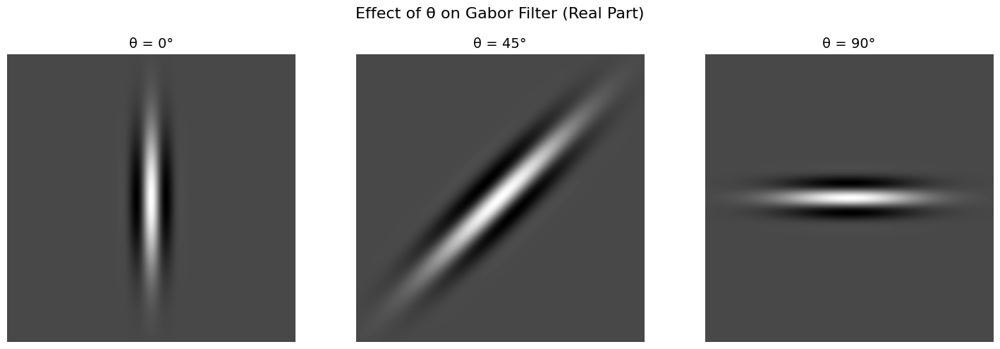

In [13]:
lamda = 30
psi = 0
sigma = 10
gamma = 0.25

thetas = [0, np.pi / 4, np.pi / 2]

fig, axes = plt.subplots(1, len(thetas), figsize=(15, 5))
fig.suptitle('Effect of θ on Gabor Filter (Real Part)', fontsize=16)

for i, theta in enumerate(thetas):
    gabor_filter = create_gabor(sigma, theta, lamda, psi, gamma)
    gabor_real = gabor_filter[:, :, 0]
    
    ax = axes[i]
    ax.imshow(gabor_real, cmap='gray')
    
    # Label the image
    ax.set_title(f'θ = {np.degrees(theta):.0f}°', fontsize=14)
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

<a id="question-11"></a>
#### <font color='#FF0000'>Question 11 (1 point)</font>

Visualize how the parameter $\sigma$ affects the Gabor filter in the spatial domain. Use the following steps:

1. Initialize the parameters as follows: $\lambda = 35$, $\theta = \pi/6$, $\psi = \pi/4$, $\sigma = 10$, $\gamma = 0.5$.
2. Set $\sigma$ to $10$, $30$, and $45$ while keeping the other parameters unchanged.
3. Generate and display the Gabor filters corresponding to each value of $\sigma$.
4. Ensure that each image in the visualization is clearly labeled to indicate the value of $\sigma$ it represents.

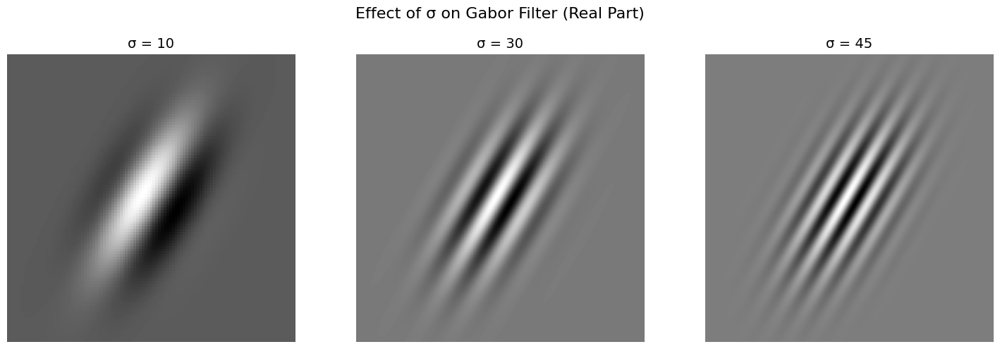

In [14]:
lamda = 35
theta = np.pi / 6
psi = np.pi / 4
gamma = 0.5

sigmas = [10, 30, 45]

fig, axes = plt.subplots(1, len(sigmas), figsize=(15, 5))
fig.suptitle('Effect of σ on Gabor Filter (Real Part)', fontsize=16)

for i, sigma in enumerate(sigmas):
    gabor_filter = create_gabor(sigma, theta, lamda, psi, gamma)
    gabor_real = gabor_filter[:, :, 0]
    
    ax = axes[i]
    ax.imshow(gabor_real, cmap='gray')
    
    ax.set_title(f'σ = {sigma}', fontsize=14)
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

<a id="question-12"></a>
#### <font color='#FF0000'>Question 12 (1 point)</font>

Visualize how the parameter $\gamma$ affects the Gabor filter in the spatial domain. Use the following steps:

1. Initialize the parameters as follows: $\lambda = 25$, $\theta = \pi/3$, $\psi = \pi/6$, $\sigma = 8$, $\gamma = 0.75$.
2. Set $\gamma$ to $.25$, $.50$, and $.75$ while keeping the other parameters unchanged.
3. Generate and display the Gabor filters corresponding to each value of $\gamma$.
4. Ensure that each image in the visualization is clearly labeled to indicate the value of $\gamma$ it represents.


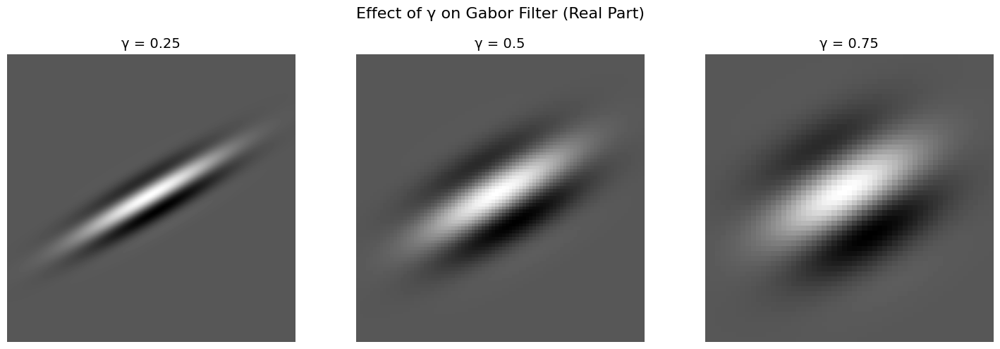

In [15]:
lamda = 25
theta = np.pi / 3
psi = np.pi / 6
sigma = 8

gammas = [0.25, 0.50, 0.75]

fig, axes = plt.subplots(1, len(gammas), figsize=(15, 5))
fig.suptitle('Effect of γ on Gabor Filter (Real Part)', fontsize=16)

for i, gamma in enumerate(gammas):
    gabor_filter = create_gabor(sigma, theta, lamda, psi, gamma)
    gabor_real = gabor_filter[:, :, 0]
    
    ax = axes[i]
    ax.imshow(gabor_real, cmap='gray')
    
    ax.set_title(f'γ = {gamma}', fontsize=14)
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

<a id="question-13"></a>
#### <font color='#FF0000'>Question 13 (6 points)</font>

Based on the visualizations of parameters and your self-study on Gabor filters, explain briefly:

1. What do the parameters $\lambda$, $\theta$, $\psi$, $\sigma$, and $\gamma$ control?
2. How do these parameters visually influence the Gabor filter kernel?

##### <font color='yellow'>Answer:</font>

### 1. What the Parameters Control:

- **λ** (Lambda): Controls the distance between the sinusoidal waves (frequency). Larger values of λ make wider spaces and smaller ones make tighter stripes. 

- **θ** (Theta): Controls the rotation of the filter. Sets the angle of the stripes in the spatial domain. 

- **ψ** (Psi): Controls the phase shift of the sinusoid. Shifts the stripes horizontally and turns them from cosine-like to sine-like patterns.

- **σ** (Sigma): Controls the spread of the Gaussian envelope. Larger values of σ make broader filters and smaller ones make more localized filters.

- **γ** (Gamma): Controls the ellipticity of the Gaussian envelope. When γ = 1 the result is circular, when γ < 1 it elongates along one axis.

### 2. How Parameters Visually Influence the Filter:

- **Lambda Effect**: Alters the thickness of the stripes. Larger values result in thicker and wider spaces, while smaller ones return thinner and tighter stripes.  

- **Theta Effect**: Rotates the entire filter. θ = 0 produces vertical stripes, while θ = π/2 produces horizontal stripes. 

- **Psi Effect**: Shifts the position of bright/dark bands inside the filter, flipping the phase. For example, ψ = 0 centers a bright stripe (cosine-like, symmetric filter), while ψ = π/2 centers a dark-to-bright transition (sine-like, antisymmetric filter).

- **Sigma Effect**: Controls the overall patch size. Larger σ means the pattern is visible over a wider area and smoother, while smaller σ makes the filter smaller and sharper.

- **Gamma Effect**: Stretches the filter's shape. Small γ makes the filter look elliptical while γ closer to 1 makes its shape more circular.

<a id="section-4"></a>
### **Section 4: Noise in digital images**

Digital images are often plagued by various types of noise that can significantly degrade their quality. These imperfections might originate during the image acquisition process, where sensors introduce noise, or through user errors, such as incorrect camera settings. For example, some medical imaging modalities generate low-resolution images (e.g., 128x128 pixels) that are particularly susceptible to noise. Given the exponential increase in the number of photos taken daily, enhancing noisy or corrupted images has become a critical area of research in image processing.

Noise in digital images can manifest in several ways, two of the most common being salt-and-pepper noise and additive Gaussian noise.

**Salt-and-Pepper Noise:** This type of noise is characterized by random occurrences of black and white pixels scattered across the image. It can result from overexposure, which creates "hot" pixels, or from defective sensors, leading to "dead" pixels. These randomly placed black and white pixels resemble the appearance of salt and pepper sprinkled on the image, hence the name.

**Additive Gaussian Noise:** Another prevalent type of noise is additive Gaussian noise, often associated with thermal effects in the camera sensor. This noise is modeled by adding a random value to each pixel in the image. The random value, denoted by $\epsilon$, is drawn from a Gaussian distribution with a mean of 0 and a standard deviation, $\sigma$, which represents the noise level. The relationship between the original image $\mathbf{I}(x)$ and the noisy image $\mathbf{I}^{\prime}(x)$ can be described by the following equation:

$\mathbf{I}^{\prime}(x) = \mathbf{I}(x) + \epsilon \quad \text{where} \quad \epsilon \sim \mathcal{N}(0, \sigma^2)$ *(Equation D)*

In this scenario, $\mathbf{I}(x)$ represents the original image, and $\mathbf{I}^{\prime}(x)$ is the resulting image after Gaussian noise has been added. The noise $\epsilon$ is sampled independently for each pixel from the Gaussian distribution $\mathcal{N}(0, \sigma^2)$, where $\sigma$ controls the intensity of the noise. As $\sigma$ increases, the image becomes progressively noisier.

Both salt-and-pepper noise and additive Gaussian noise are common in real-world imaging scenarios and require effective noise reduction techniques. In the upcoming sections, we will explore various methods for mitigating these types of noise, enhancing the quality of digital images, and ensuring that the final images are closer to their true representations.

<a id="question-14"></a>
#### <font color='#FF0000'>Question 14 (2 points)</font>

The Peak Signal-to-Noise Ratio (PSNR) is a commonly used metric for quantitatively evaluating the performance of image enhancement algorithms. It is derived from the Mean Squared Error (MSE), which measures the average squared difference between the original image and the enhanced (or approximated) image. The MSE is defined as:

$MSE = \frac{1}{m \cdot n} \sum_{x,y}\left[\mathbf{I}(x,y) - \mathbf{\hat{I}}(x,y)\right]^2$ *(Equation E)*

where $\mathbf{I}$ is the original image of size $m \times n$, and $\mathbf{\hat{I}}$ is the enhanced or approximated version of the image.

The PSNR is then calculated using the MSE, and it quantifies how close the enhanced image is to the original image. The PSNR is defined as:

$PSNR = 10 \cdot \log_{10} \left(\frac{\mathbf{I}_{max}^2}{MSE}\right) \\
= 20 \cdot \log_{10} \left(\frac{\mathbf{I}_{max}}{\sqrt{MSE}}\right) \\
= 20 \cdot \log_{10} \left(\frac{\mathbf{I}_{max}}{RMSE}\right)$

where $\mathbf{I}_{max}$ is the maximum possible pixel value of the image (e.g., 255 for an 8-bit image), and $RMSE$ is the root of the MSE.

Given this understanding, answer the following:

When comparing different methods using the PSNR metric, is a higher value better, or is the opposite true? Explain your answer briefly.

##### <font color='yellow'>Answer:</font>

A higher $PSNR$ means that $\frac{I_{max}}{RMSE}$ is larger. This would mean that the $RMSE$ is relatively smaller than the maximum value that the pixels can take, which means that the error is small. It is therefore better to have a higher PSNR.

<a id="question-15"></a>
#### <font color='#FF0000'>Question 15 (4 points)</font>

Implement the function `calculate_psnr()` to calculate the Peak Signal-to-Noise Ratio (PSNR) for both grayscale and RGB images. The function should take two images as input: the original image and its enhanced (or approximated) version.

When implementing `calculate_psnr()`, ensure that it works correctly for both grayscale and RGB images. For RGB images, consider how the PSNR formula should be adjusted. Specifically, think about whether to compute the PSNR for each channel separately and then combine the results, or handle the RGB image differently.

**Note:** You are not allowed to use any Python built-in functions from the *PIL* or *Skimage* libraries or any other libraries except for *NumPy*.

In [16]:
def calculate_psnr(orig_image, approx_image):
    '''
    Computes the PSNR (Peak Signal-to-Noise Ratio) between an original image and its enhanced version.

    Args:
        orig_image: The original image (can be grayscale or RGB).
        approx_image: The enhanced or approximated version of the original image.

    Returns:
        psnr_value: The PSNR value in decibels (dB).
    '''

    if len(orig_image.shape) == 3:
        imtype = "RGB"
        h, w, _ = orig_image.shape
    else:
        imtype = "Grayscale"
        h, w = orig_image.shape
    
    Imax = 1 # Assume that the input has dtype=float32
    
    diff_image = orig_image - approx_image
    
    if imtype == "Grayscale":
        RMSE = np.linalg.norm(diff_image) / np.sqrt(h * w)
        # Make sure we don't divide by zero
        if RMSE == 0:
            return 10 ** 10
        psnr_value = 20 * np.log10(Imax / RMSE)
    
    # In the case of 3 channels, we treat it like we have 3 times as many pixels
    if imtype == "RGB":
        RMSE = np.linalg.norm(diff_image) / np.sqrt(h * w * 3)
        # Make sure we don't divide by zero
        if RMSE == 0:
            return 10 ** 10
        
        psnr_value = 20 * np.log10(Imax / RMSE)
        
    return psnr_value

<a id="question-16"></a>
#### <font color='#FF0000'>Question 16 (1 point)</font>

Using your implemented function `calculate_psnr()`, compute and print the PSNR between `frans_bauer.png` and `frans_bauer_salt_pepper.png`.

**Hint:** Ensure that the data type of the images is `float32` before computation.

In [17]:
# Import images
frans_bauer = cv2.imread("images/frans_bauer.png")
frans_bauer_salt_pepper = cv2.imread("images/frans_bauer_salt_pepper.png")

# Convert to float
frans_bauer = frans_bauer.astype(np.float32) * (1/ 255)
frans_bauer_salt_pepper = frans_bauer_salt_pepper.astype(np.float32)* (1/ 255)

print(calculate_psnr(frans_bauer, frans_bauer_salt_pepper))

17.92140065900511


<a id="question-17"></a>
#### <font color='#FF0000'>Question 17 (1 point)</font>

Using your implemented function `calculate_psnr()`, compute and print the PSNR between `frans_bauer.png` and `frans_bauer_gaussian.png`.

**Hint:** Ensure that the data type of the images is `float32` before computation.

In [18]:
# Import images
frans_bauer = cv2.imread("images/frans_bauer.png")
frans_bauer_gaussian = cv2.imread("images/frans_bauer_gaussian.png")

# Convert to float
frans_bauer = frans_bauer.astype(np.float32) * (1/ 255)
frans_bauer_gaussian = frans_bauer_gaussian.astype(np.float32)* (1/ 255)

print(calculate_psnr(frans_bauer, frans_bauer_gaussian))

27.735995682097748


<a id="question-18"></a>
#### <font color='#FF0000'>Question 18 (3 points)</font>

Design a function called `denoise_image()` to remove two types of noise: salt-and-pepper noise and Gaussian noise. The function should denoise the image by applying one of the following methods: box filtering using **cv2.blur** function, median filtering using **cv2.medianBlur** function, or Gaussian filtering using **cv2.GaussianBlur** function.

In [19]:
def denoise_image(input_image, kernel_type, kernel_size=3, sigma=1):
    '''
    Function denoises the image using the specified kernel type:
    - 'box': by using a box filter
    - 'median': by using a median filter
    - 'gaussian': by using a gaussian filter
    
    Args:
        input_image: The input image to be denoised.
        kernel_type: A string specifying the type of filter ('box', 'median', or 'gaussian').
        kernel_size: Size of the kernel to be used for filtering (default is 3).
        sigma: Standard deviation for the Gaussian kernel (used only for the gaussian filter).

    Returns:
        denoised_image: The denoised image.
    '''

    if kernel_type == 'box':
        denoised_image = cv2.blur(input_image, (kernel_size, kernel_size))

    elif kernel_type == 'median':
        denoised_image = cv2.medianBlur(input_image, kernel_size)

    elif kernel_type == 'gaussian':
        denoised_image = cv2.GaussianBlur(input_image, (kernel_size, kernel_size), sigmaX=sigma, sigmaY=sigma)
    else:
        raise ValueError('Kernel type not implemented. Choose between "box", "median", or "gaussian".')

    return denoised_image

<a id="question-19"></a>
#### <font color='#FF0000'>Question 19 (2 points)</font>

Using your implemented function **denoise_image()**, denoise the `frans_bauer_salt_pepper.png` and `frans_bauer_gaussian.png` images by applying box filtering with kernel sizes of 3x3, 5x5, and 7x7. Display the resulting denoised images.

In [20]:
# Different parameters for better readibility
plt.rcParams.update({
    'font.size': 8,        # Default text size
    'axes.titlesize': 8,   # Title size
    'axes.labelsize': 16,   # Axis label size
    'legend.fontsize': 14,  # Legend font size
    'xtick.labelsize': 15,  # Tick size
    'ytick.labelsize': 15,
    'figure.dpi': 200       # High DPI for clarity
})

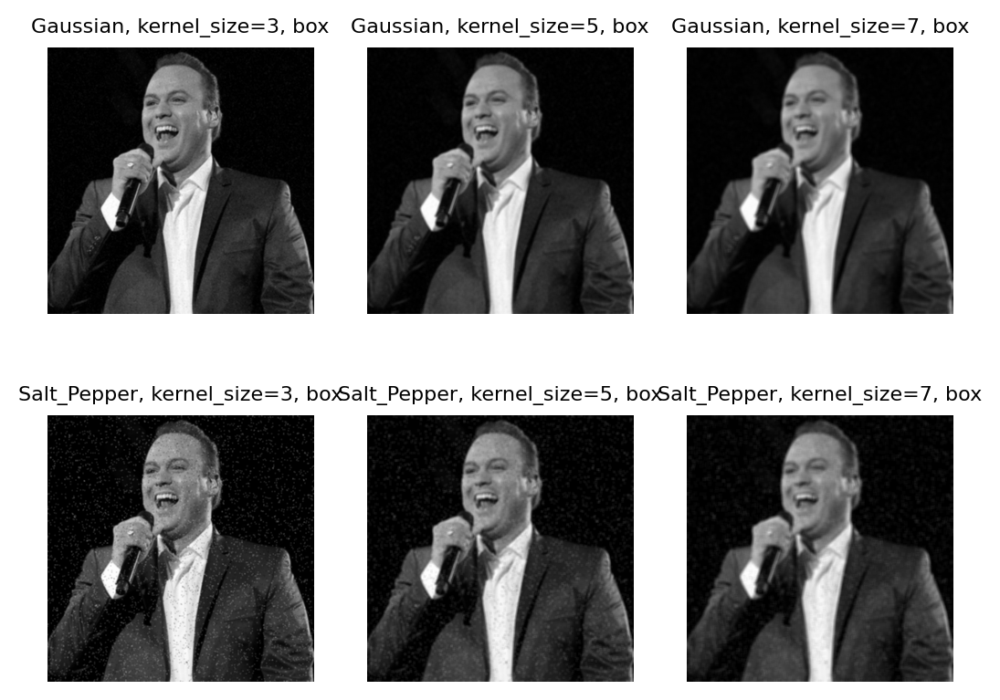

In [21]:
frans_bauer = cv2.imread("images/frans_bauer.png")
frans_bauer_gaussian = cv2.imread("images/frans_bauer_gaussian.png")
frans_bauer_salt_pepper = cv2.imread("images/frans_bauer_salt_pepper.png")

i = 1
for x in [3, 5, 7]:
    frans_bauer_gaussian_boxed = denoise_image(frans_bauer_gaussian, 'box', x)
    frans_bauer_salt_pepper_boxed = denoise_image(frans_bauer_salt_pepper, 'box', x)
    
    plt.subplot(2, 3, i)
    plt.axis('off')
    plt.imshow(frans_bauer_gaussian_boxed)
    plt.title(f'Gaussian, kernel_size={x}, box')
    
    plt.subplot(2, 3, i + 3)
    plt.axis('off')
    plt.title(f'Salt_Pepper, kernel_size={x}, box')
    plt.imshow(frans_bauer_salt_pepper_boxed)
    
    i += 1

<a id="question-20"></a>
#### <font color='#FF0000'>Question 20 (2 points)</font>

Using your implemented function **denoise_image()**, denoise the `frans_bauer_salt_pepper.png` and `frans_bauer_gaussian.png` images by applying median filtering with kernel sizes of 3x3, 5x5, and 7x7. Display the resulting denoised images.

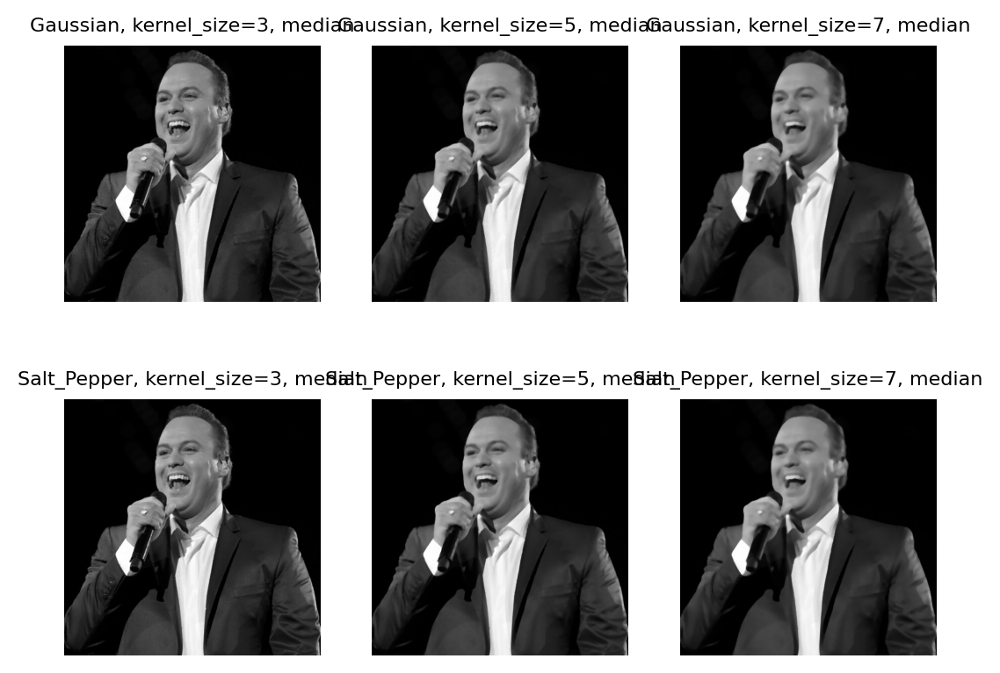

In [22]:
frans_bauer = cv2.imread("images/frans_bauer.png")
frans_bauer_gaussian = cv2.imread("images/frans_bauer_gaussian.png")
frans_bauer_salt_pepper = cv2.imread("images/frans_bauer_salt_pepper.png")

i = 1
for x in [3, 5, 7]:
    frans_bauer_gaussian_median = denoise_image(frans_bauer_gaussian, 'median', x)
    frans_bauer_salt_pepper_median = denoise_image(frans_bauer_salt_pepper, 'median', x)
    
    plt.subplot(2, 3, i)
    plt.axis('off')
    plt.imshow(frans_bauer_gaussian_median)
    plt.title(f'Gaussian, kernel_size={x}, median')
    
    plt.subplot(2, 3, i + 3)
    plt.axis('off')
    plt.title(f'Salt_Pepper, kernel_size={x}, median')
    plt.imshow(frans_bauer_salt_pepper_median)
    
    i += 1

<a id="question-21"></a>
#### <font color='#FF0000'>Question 21 (3 points)</font>

Using your implemented function **my_psnr()**, compute the PSNR for each of the 12 denoised images (from Questions 19 and 20) with respect to the original `frans_bauer.png` image. Present your results in a clear and readable format **and** discuss the effect of the filter size on the PSNR. 

**Hint:** Ensure that the images are loaded as `float32` before computation.

Difference to regular Frans Bauer:
Errors without denoising:
Gaussian: 27.735995682097748
Salt&Pepper: 17.92140065900511

Kernel_Size = 3
Frans Bauer Gaussian, mode=box, PSNR=30.896462348078487
Frans Bauer Gaussian, mode=median, PSNR=34.337171235044735
Frans Bauer Salt & Pepper, mode=box, PSNR=25.785633941313876
Frans Bauer Salt & Pepper, mode=median, PSNR=34.83200473165907

Kernel_Size = 5
Frans Bauer Gaussian, mode=box, PSNR=28.322942335607408
Frans Bauer Gaussian, mode=median, PSNR=31.26655758510772
Frans Bauer Salt & Pepper, mode=box, PSNR=26.402207780055864
Frans Bauer Salt & Pepper, mode=median, PSNR=31.34076673187604

Kernel_Size = 7
Frans Bauer Gaussian, mode=box, PSNR=26.79307849516504
Frans Bauer Gaussian, mode=median, PSNR=29.654212158809294
Frans Bauer Salt & Pepper, mode=box, PSNR=25.769705701831715
Frans Bauer Salt & Pepper, mode=median, PSNR=29.711949271495577



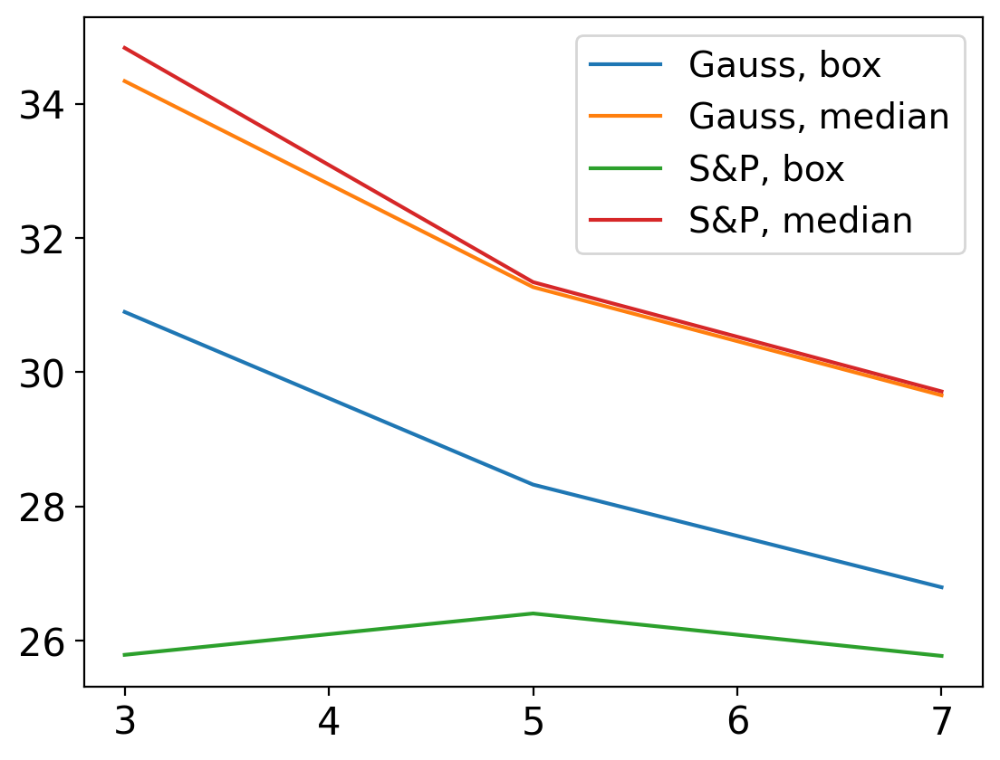

In [23]:
def int_to_float(img):
    return img.astype(np.float32) / 255
    

def float_to_int(img):
    return (img * 255).astype(np.uint8)

frans_bauer = cv2.imread("images/frans_bauer.png")
frans_bauer_gaussian = cv2.imread("images/frans_bauer_gaussian.png")
frans_bauer_salt_pepper = cv2.imread("images/frans_bauer_salt_pepper.png")

frans_bauer = int_to_float(frans_bauer)
x_values = [3, 5, 7]

psnr_gaussian_boxed = []
psnr_gaussian_median = []
psnr_salt_pepper_boxed = []
psnr_salt_pepper_median = []

print("Difference to regular Frans Bauer:")
print(f"Errors without denoising:\nGaussian: {calculate_psnr(frans_bauer, int_to_float(frans_bauer_gaussian))}\nSalt&Pepper: {calculate_psnr(frans_bauer, int_to_float(frans_bauer_salt_pepper))}\n")
for x in x_values:
    print("Kernel_Size =", x)
    
    frans_bauer_gaussian_boxed = int_to_float(denoise_image(frans_bauer_gaussian, 'box', x))
    frans_bauer_gaussian_median = int_to_float(denoise_image(frans_bauer_gaussian, 'median', x))
    frans_bauer_salt_pepper_boxed = int_to_float(denoise_image(frans_bauer_salt_pepper, 'box', x))
    frans_bauer_salt_pepper_median = int_to_float(denoise_image(frans_bauer_salt_pepper, 'median', x))
    
    psnr_gaussian_boxed.append(calculate_psnr(frans_bauer, frans_bauer_gaussian_boxed))
    psnr_gaussian_median.append(calculate_psnr(frans_bauer, frans_bauer_gaussian_median))
    psnr_salt_pepper_boxed.append(calculate_psnr(frans_bauer, frans_bauer_salt_pepper_boxed))
    psnr_salt_pepper_median.append(calculate_psnr(frans_bauer, frans_bauer_salt_pepper_median))
    
    print(f"Frans Bauer Gaussian, mode=box, PSNR={calculate_psnr(frans_bauer, frans_bauer_gaussian_boxed)}")
    print(f"Frans Bauer Gaussian, mode=median, PSNR={calculate_psnr(frans_bauer, frans_bauer_gaussian_median)}")
    print(f"Frans Bauer Salt & Pepper, mode=box, PSNR={calculate_psnr(frans_bauer, frans_bauer_salt_pepper_boxed)}")
    print(f"Frans Bauer Salt & Pepper, mode=median, PSNR={calculate_psnr(frans_bauer, frans_bauer_salt_pepper_median)}")
    print("")

# Plot the results (not very insightful, but still possible)
plt.plot(x_values, psnr_gaussian_boxed)
plt.plot(x_values, psnr_gaussian_median)
plt.plot(x_values, psnr_salt_pepper_boxed)
plt.plot(x_values, psnr_salt_pepper_median)

plt.legend(["Gauss, box", "Gauss, median", "S&P, box", "S&P, median"])
plt.show()

##### <font color='yellow'>Answer:</font>

We can make the following observations:
- Applying a filter with kernel-size 3 with the both modes gives a better result in both the Gaussian and Salt&Pepper cases.
- Using a kernel-size of 7 with the 'box' mode gives a worse result on the Gaussian case.
- In both images, the median-mode gives a higher $PSNR$-value than the box-mode.

We will now explain these differences. We must first notice that, since the $PSNR$-value is calculated using the mean sum of squares. This means that a small difference in pixels contributes significantly less than a higher difference in pixels. 
- A smaller kernel-size gives us better results, because it preserves the most amount of the original image. In a perfect world, we would remove noise from the image and leave the non-noisy pixels as they are. Unfortunately, we will always alter the picture a bit when using a denoising algorithm like the 'box' or 'median' method. This would give larger errors as the kernel-size increases.
- The 'box' mode has a 'smearing' effect on the noise. A large difference in a single pixel will be distributed as a smaller difference over multiple pixels. Because of the point made before about the fact that smaller errors contribute less, means that using a box filter does increase the $PSNR$-value. The 'box' mode also gives all pixels a small error, because all of the values will change depending on the surrounding pixels.
- The 'median' mode gives a very good result on both cases. This can be explained by noticing that the 'median' mode does remove the noise (in certain cases) and can therefore decrease the error by a large amount.

<a id="question-22"></a>
#### <font color='#FF0000'>Question 22 (2 points)</font>

Which filter is more effective for removing salt-and-pepper noise, box or median filters? Explain your reasoning. Also, consider which filter performs better for Gaussian noise and why.

##### <font color='yellow'>Answer:</font>

To remove salt-and-pepper noise, the median filter is the most effective. This is, because the salt-and-pepper noise give outliers in the normal structure of the image. In the cases where the image is smooth enough, most pixel values will lie close together. This would mean that the noisy pixels will never be the median, so they are removed very effectively.

To remove Gaussian noise, the median filter also seems to be the most effective. This is because the median filter is good in removing large differences in the image. Because of this, the median filter also removes a lot of the noise in the Gaussian case. The 'box' method works less effectively, because the major errors stay in the image, but they get smaller. 

<a id="question-23"></a>
#### <font color='#FF0000'>Question 23 (2 points)</font>

Using your implemented function **denoise_image()**, denoise the `frans_bauer_gaussian.png` image by applying Gaussian filtering with kernel sizes of 3x3, 5x5, and 7x7, and standard deviations of 0.5, 1, 3, and 7.

Display the resulting denoised images.

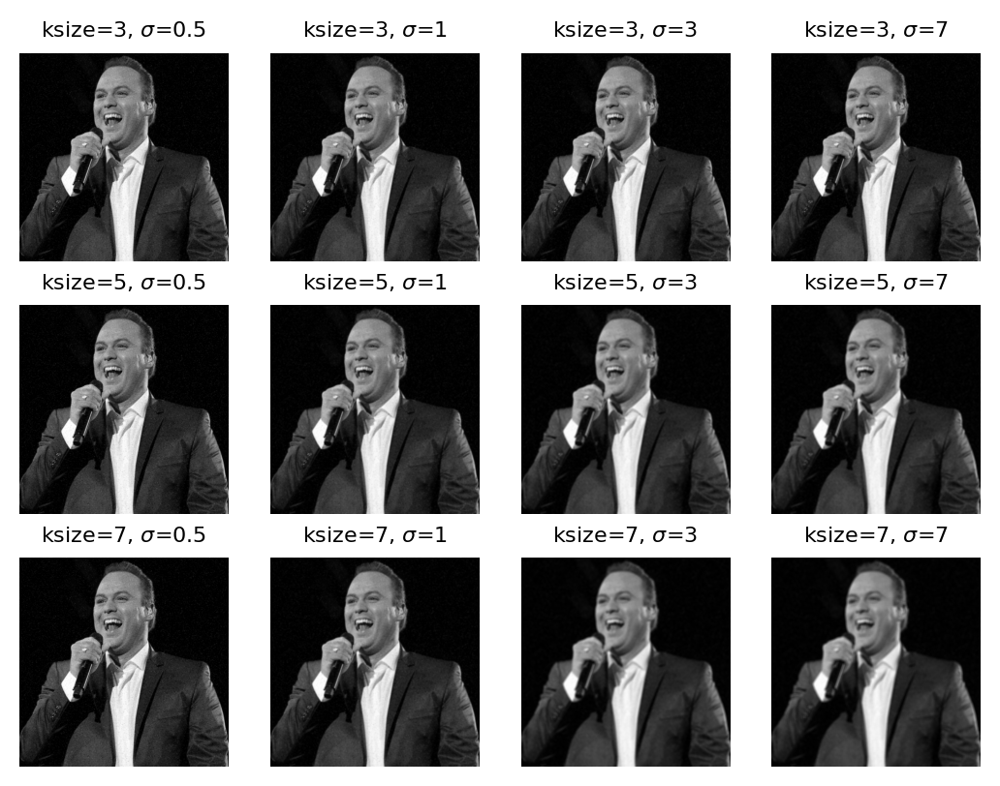

In [24]:
frans_bauer = cv2.imread("images/frans_bauer.png")
frans_bauer_gaussian = cv2.imread("images/frans_bauer_gaussian.png")
frans_bauer_salt_pepper = cv2.imread("images/frans_bauer_salt_pepper.png")

kernel_sizes = [3, 5, 7]
standard_deviations = [0.5, 1, 3, 7]

for i, k in enumerate(kernel_sizes):
    for j, sigma in enumerate(standard_deviations):
        plt.subplot(len(kernel_sizes), len(standard_deviations), 1 + i * len(standard_deviations) + j)
        plt.axis('off')
        frans_bauer_gaussian_gaussian = denoise_image(frans_bauer_gaussian, 'gaussian', k, sigma=sigma)
        plt.imshow(frans_bauer_gaussian_gaussian)
        plt.title(fr"ksize={k}, $\sigma$={sigma}")
plt.show()
        

<a id="question-24"></a>
#### <font color='#FF0000'>Question 24 (3 points)</font>

Present your results for the PSNR scores of the 12 images from Question 22 in a clear and readable format **and** discuss the effect of the standard deviation on the PSNR.

PSNR-value without denoising= 27.735995682097748


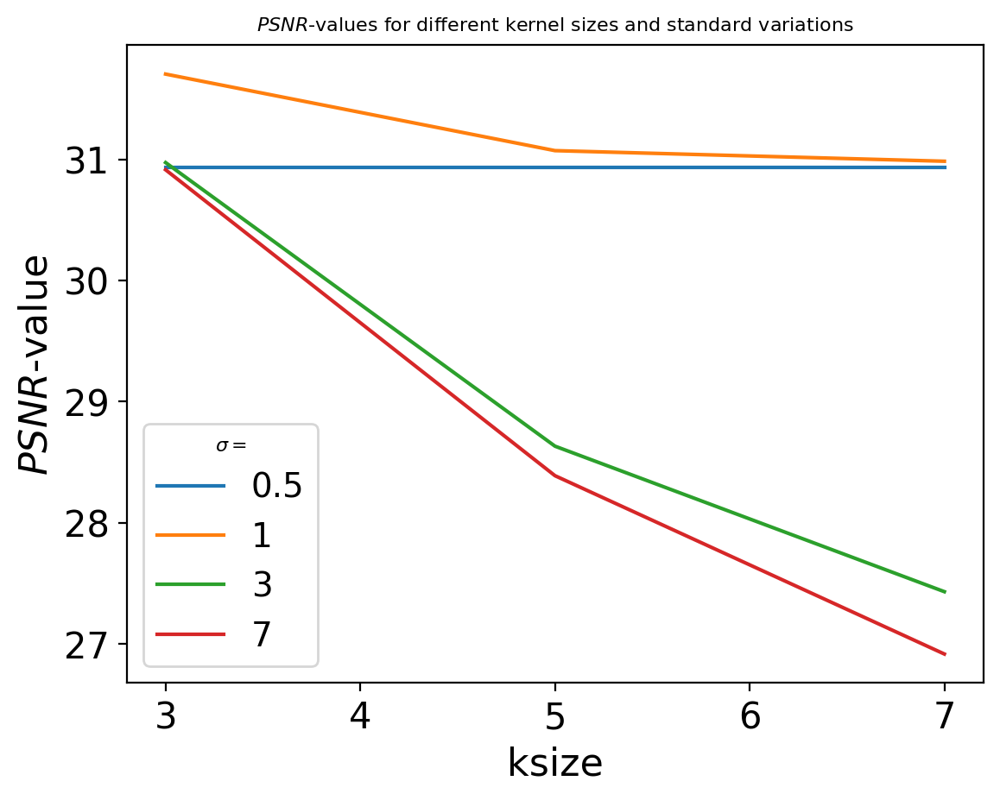

In [25]:
frans_bauer = int_to_float(cv2.imread("images/frans_bauer.png"))
frans_bauer_gaussian = cv2.imread("images/frans_bauer_gaussian.png")
frans_bauer_salt_pepper = cv2.imread("images/frans_bauer_salt_pepper.png")

print(f"PSNR-value without denoising= {calculate_psnr(frans_bauer, int_to_float(frans_bauer_gaussian))}")

kernel_sizes = [3, 5, 7]
standard_deviations = [0.5, 1, 3, 7]

psnr_values = {}

for sigma in standard_deviations:
    psnr_values = []
    for k in kernel_sizes:
        frans_bauer_gaussian_gaussian = int_to_float(denoise_image(frans_bauer_gaussian, 'gaussian', k, sigma=sigma))
        psnr_values.append(calculate_psnr(frans_bauer, frans_bauer_gaussian_gaussian))
    plt.plot(kernel_sizes, psnr_values)
    
plt.xlabel("ksize")
plt.ylabel("$PSNR$-value")
plt.title("$PSNR$-values for different kernel sizes and standard variations")
plt.legend(standard_deviations, title=r"$\sigma =$")
        

##### <font color='yellow'>Answer:</font>

We can here see the following:
- A larger kernel-size will never give a higher $PSNR$-value for all $\sigma$.
- Applying the 'Gaussian' mode with a small kernel size gives a higher $PSNR$-value for all chosen $\sigma$ than not using the Gaussian filter.
- For the cases that we tested, we see that the value $\sigma=1$ gives the best $PSNR$-value. This means that we want to choose our standard deviation to be not too small, because that the Gaussian kernel doesn't have a lot of effect, but also not too large, because then the Gaussian kernel overcorrects the image and makes it more blurry. 
- A larger standard deviation gives a larger difference as the kernel size increases. This can be explained by the fact that a large standard deviation will have a higher interaction with pixels that are far away. When using a smaller kernel size, this will be less noticable, because there are not enough pixels in the kernel for this effect to take place. When the kernel size increases, this effect will become noticable, because the pixels that we interact with are now in the kernel. 

<a id="question-25"></a>
#### <font color='#FF0000'>Question 25 (2 points)</font>

What is the difference among median filtering, box filtering, and Gaussian filtering? Briefly explain how they are different at a conceptual level. If two filtering methods give similar PSNR values, can you see a qualitative difference?

##### <font color='yellow'>Answer:</font>

- The box mode 'smears' the image. Therefore, the errors get distributed evenly onto the surrounding pixels, resulting in a lot of smaller errors. The image will also become very blurry as the kernel-size increases.
- The median mode takes the median value of a kernel. A median is very useful in removing outliers, since they will generaly lie in the higher/lower ends of the kernel. It can be insightful to visualise this by having 5 people of ages [10, 10, 10, 10, 80]. The box mode would take the average, which is 24, but this has a large error, since none of the people have an age close to 24. The median would be 10, which is more insightful on the dataset. This effect is less noticable when the values are closer together i.e. there is less noise.
- The Gaussian mode gives surrounding pixels a priority with pixels further away getting a lower priority (dependent on the variance). This will reduce noise pixels, because it takes a weighted mean, meaning that the noise will decrease. The noise will not be entirely removed, which is especially noticable with large outliers (Salt&Pepper noise for example). The Gaussian mode is also better at preserving the structure of the image than for example the box mode.

For the errors, the box method will result in a lot off very small errors. The median mode will result in a smaller amount of larger errors. Finally, the Gaussian mode will sit somewhere in between these two cases. 

<a id="section-5"></a>
### **Section 5: Edge Detection**

Edges in digital images represent areas where there is a significant change in brightness, often corresponding to the boundaries of objects. Detecting these edges is a crucial task in many computer vision applications, such as autonomous driving, where edge detection can be used to identify road boundaries and determine the vehicle's trajectory.

In this section, we will explore various techniques for edge detection, focusing specifically on filters that extract the gradient of the image. The gradient represents the rate of change in brightness and is calculated using first-order derivative filters. The Sobel operator, one of the most common methods, approximates the first derivative of a Gaussian filter and is used to detect edges by highlighting the intensity gradients in an image.

The Sobel operator uses two 3x3 convolution kernels, one for detecting changes in the horizontal direction (G_x) and the other for the vertical direction (G_y). The kernels are defined as follows:

$G_x = \begin{bmatrix} +1 & 0 & -1 \\ +2 & 0 & -2 \\ +1 & 0 & -1 \end{bmatrix} * \mathbf{I}$

$G_y = \begin{bmatrix} +1 & +2 & +1 \\ 0 & 0 & 0 \\ -1 & -2 & -1 \end{bmatrix} * \mathbf{I}$

The gradient magnitude, which combines the horizontal and vertical gradients, is given by:

$G =\sqrt {{G_x}^2+{G_y}^2}$

The direction of the gradient, indicating the orientation of the edge, is calculated as:

$\theta= \tan^{-1}\left(\frac{G_y}{G_x}\right)$

These calculations allow us to detect and quantify edges in an image. In this section, we will apply these methods to extract edges from images, with a particular focus on detecting roads in still images, which is a critical task in autonomous driving systems.

<a id="question-26"></a>
#### <font color='#FF0000'>Question 26 (4 points)</font>

Implement the function **compute_image_gradient()** to compute the gradients of an image. This function should calculate the gradients in both the x and y directions, as well as the gradient magnitude and direction.

You are not allowed to use Python built-in functions for computing gradients, but you may use the `scipy.signal.convolve2d` function for performing 2D convolution.

Additionally, complete the helper function **normalize_image()** to normalize the gradients.

In [26]:
def normalize_image(image: np.ndarray, low=0, high=1) -> np.ndarray:
    '''
    Normalizes the input image to a specified range [low, high].

    Args:
        image: The input image as a numpy array.
        low: The lower bound of the normalization range (default is 0).
        high: The upper bound of the normalization range (default is 1).

    Returns:
        normalized_image: The normalized image as a numpy array.
    '''

    # Convert the image to float32 for precision during normalization
    image = image.astype(np.float32)

    image_min = np.min(image)
    image_max = np.max(image)
    normalized_image = (image - image_min) / (image_max - image_min)

    normalized_image = image * (high - low) + low

    return normalized_image

In [27]:
def compute_image_gradient(input_image: np.ndarray):
    '''
    Computes the gradients of the input image in both x and y directions,
    along with the gradient magnitude and direction.

    Args:
        input_image: The input image as a 2D numpy array.

    Returns:
        gradient_x: The gradient of the image in the x direction.
        gradient_y: The gradient of the image in the y direction.
        gradient_magnitude: The magnitude of the gradient.
        gradient_direction: The direction of the gradient (in degrees).
    '''

    # Sobel kernels for x and y directions
    sobel_x = [[1, 0, -1],
               [2, 0, -2],
               [1, 0, -1]]

    sobel_y = [[1, 2, 1],
               [0, 0, 0],
               [-1, -2, -1]]

    gradient_x = scipy.signal.convolve2d(input_image, sobel_x, mode='same', boundary='symm')
    gradient_y = scipy.signal.convolve2d(input_image, sobel_y, mode='same', boundary='symm')

    gradient_magnitude = np.sqrt(gradient_x**2 + gradient_y**2)
    gradient_direction = np.arctan2(gradient_y, gradient_x, where=gradient_x!=0) * (180 / np.pi)

    return normalize_image(gradient_x), normalize_image(gradient_y), normalize_image(gradient_magnitude), normalize_image(gradient_direction)

<a id="question-27"></a>
#### <font color='#FF0000'>Question 27 (3 points)</font>

Using your implemented function **compute_image_gradient()** on `landscape.jpg`, display the following figures:

1. The gradient of the image in the x-direction.
2. The gradient of the image in the y-direction.
3. The gradient magnitude of each pixel.
4. The gradient direction of each pixel.

Discuss what kind of information each image conveys.

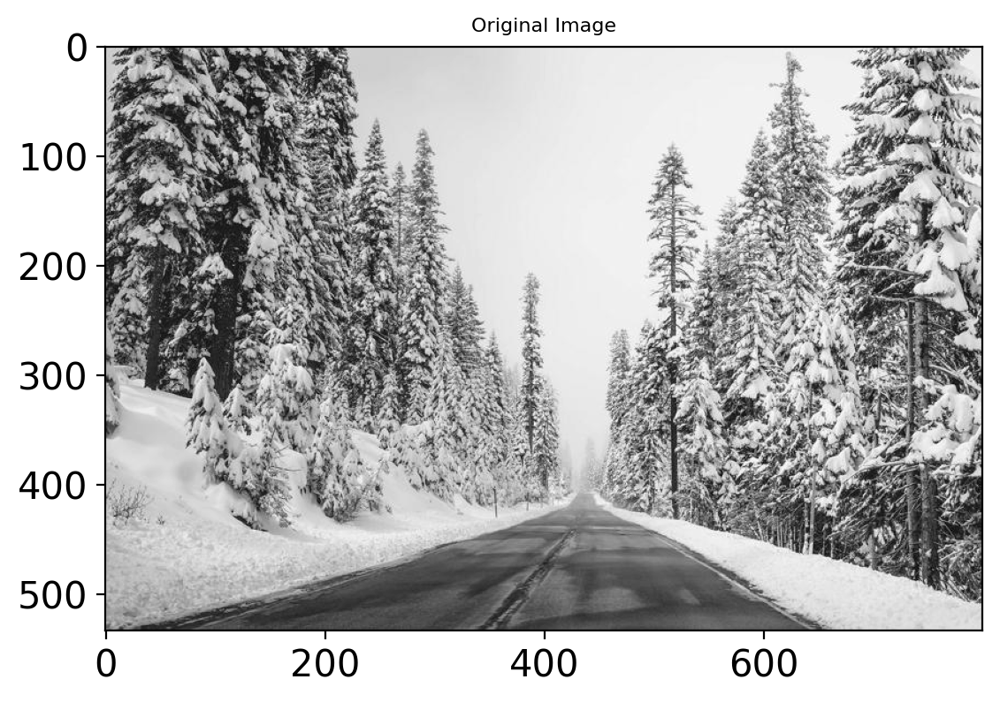

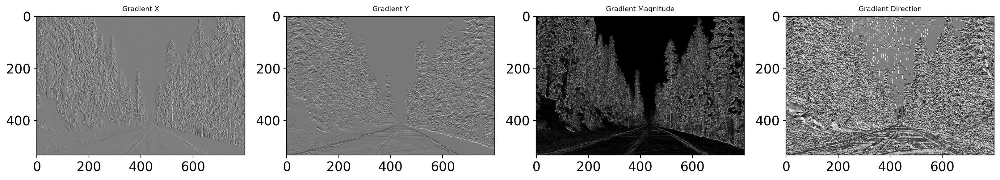

In [28]:
image = cv2.imread('./images/landscape.jpg', cv2.IMREAD_GRAYSCALE)

image_array = np.array(image)

gradient_x, gradient_y, gradient_magnitude, gradient_direction = compute_image_gradient(image_array)

plt.title('Original Image')
plt.imshow(image, cmap='gray')  

plt.subplots(1, 4, figsize=(20, 20))
plt.subplot(1, 4, 1)
plt.title('Gradient X')
plt.imshow(gradient_x, cmap='gray')

plt.subplot(1, 4, 2)
plt.title('Gradient Y')
plt.imshow(gradient_y, cmap='gray')

plt.subplot(1, 4, 3)
plt.title('Gradient Magnitude')
plt.imshow(gradient_magnitude, cmap='gray')

plt.subplot(1, 4, 4)
plt.title('Gradient Direction')
plt.imshow(gradient_direction, cmap='gray')

plt.show()

##### <font color='yellow'>Answer:</font>

Precisely detecting edges in images is a quite difficult task, and a reasonable approach is to define an edge as a location of rapid intensity or color variation. If we think of the image as an height field, edges occur at locations of steep slopes. \
In this sense, the gradient of the image defines the slope and direction of an image in a mathematical way:
* The gradient of the image in the $\mathbf{x}$ direction detects changes in the horizontal direction, like the the logs of the trees present in the image
* The gradient of the image in the $\mathbf{y}$ direction does the same in the vertical direction, highlighting for example the borders of the road
* The gradient magnitude of each pixel gives us information about the slope or strength of the variation, making the real edges of the image whiter than the background
* The gradient direction points in a direction perpendicular to the local contour

Source: _"Computer Vision: Algorithms and Applications" by R. Szeliski, September 2021_

<a id="question-28"></a>
#### <font color='#FF0000'>Question 28 (4 points)</font>

Compared to the Sobel filter, a Laplacian of Gaussian (LoG) relies on the second derivative of a Gaussian filter. Hence, it will focus on large gradients in the image.

Implement the function **compute_laplacian_of_gaussian()** to compute the Laplacian of Gaussian (LoG) for an image using each the following methods:

1. Smoothing the image with a Gaussian kernel, then applying the Laplacian (second derivative) to the smoothed image.
2. Convolving the image directly with a LoG kernel.
3. Computing the Difference of Gaussians (DoG) at different scales $\sigma_1$ and $\sigma_2$.

The function should take arguments *method*, *kernel_size*, *sigma*, *sigma_1*, and *sigma_2* to specify the parameters for each method.

**Note:** You are not allowed to use Python built-in functions for computing LoG kernels, but you can use `scipy.signal.convolve2d` for 2D convolution.

In [29]:
def compute_laplacian_of_gaussian(image, method, kernel_size=5, sigma=0.5, sigma_1=0.5, sigma_2=1.0):
    '''
    Computes the Laplacian of Gaussian (LoG) using the specified method.

    Args:
        image: Input image as a 2D numpy array.
        method: Specifies which method to use (1, 2, or 3).
        kernel_size: Size of the Gaussian kernel (default is 5).
        sigma: Standard deviation of the Gaussian for methods 1 and 2 (default is 0.5).
        sigma_1: Standard deviation of the first Gaussian for method 3 (default is 0.5).
        sigma_2: Standard deviation of the second Gaussian for method 3 (default is 1.0).

    Returns:
        log_image: The resulting image after applying the Laplacian of Gaussian.
    '''

    # Define the Laplacian kernel for the second derivative
    laplacian_kernel = np.array([[0, -1, 0],
                                 [-1, 4, -1],
                                 [0, -1, 0]])

    if method == 1:
        # Method 1: Smooth the image with a Gaussian filter, then apply the Laplacian operator
        smoothed_image = scipy.signal.convolve2d(image, gaussian_kernel_2D(sigma, sigma, kernel_size), mode='same', boundary='symm')

        log_image = scipy.signal.convolve2d(smoothed_image, laplacian_kernel, mode='same', boundary='symm')

    elif method == 2:
        # Method 2: Direct convolution with a LoG kernel
        center = kernel_size // 2
        x, y = np.meshgrid(np.arange(-center, center + 1), 
                          np.arange(-center, center + 1))
        
        # Analytical LoG formula
        log_kernel = -(1/(np.pi * sigma**4)) * (1 - (x**2 + y**2)/(2*sigma**2)) * \
                     np.exp(-(x**2 + y**2)/(2*sigma**2))
        
        # Normalize the kernel
        log_kernel = log_kernel / np.sum(np.abs(log_kernel))
        
        log_image = scipy.signal.convolve2d(image, log_kernel, mode='same', boundary='symm')

    elif method == 3:
        # Method 3: Difference of Gaussians (DoG)
        gaussian_1 = gaussian_kernel_2D(sigma_1, sigma_1, kernel_size)
        gaussian_2 = gaussian_kernel_2D(sigma_2, sigma_2, kernel_size)
        
        if sigma_2 <= sigma_1:
            DoG = gaussian_2 - gaussian_1
        else:
            DoG = gaussian_1 - gaussian_2

        
        log_image = scipy.signal.convolve2d(image, DoG, mode='same', boundary='symm')

    else:
        raise ValueError("Invalid method. Choose 1, 2, or 3.")

    return log_image

<a id="question-29"></a>
#### <font color='#FF0000'>Question 29 (1 point)</font>

Test your **compute_laplacian_of_gaussian()** function using `landscape.jpg` and visualize your results using the three methods. Use the default parameters provided for each method.

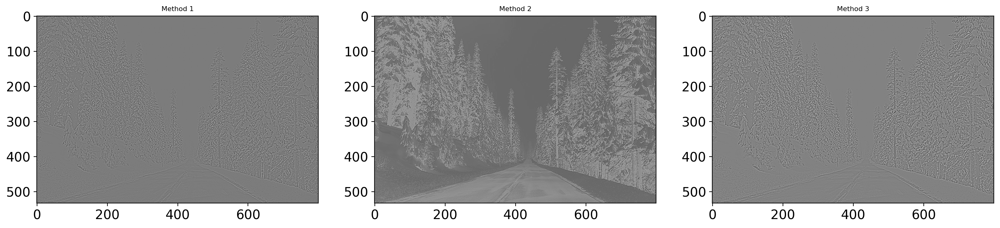

In [30]:
method1 = compute_laplacian_of_gaussian(image_array, method=1)

method2 = compute_laplacian_of_gaussian(image_array, method=2)

method3 = compute_laplacian_of_gaussian(image_array, method=3)

plt.subplots(1, 3, figsize=(20, 20))
plt.subplot(1, 3, 1)
plt.title('Method 1')
plt.imshow(method1, cmap='gray')

plt.subplot(1, 3, 2)
plt.title('Method 2')
plt.imshow(method2, cmap='gray')

plt.subplot(1, 3, 3)
plt.title('Method 3')
plt.imshow(method3, cmap='gray')

plt.show()

<a id="question-30"></a>
#### <font color='#FF0000'>Question 30 (2 points)</font>

Discuss the differences between applying the three methods of the Laplacian of Gaussian (LoG) on `landscape.jpg`. Consider how each method approaches edge detection and the visual results produced by each technique.

##### <font color='yellow'>Answer:</font>

The three methods we apply display three different results for `landscape.jpg`:
* The first method applies two convolutions on the input image. The first one smoothes the image using a gaussian kernel and the second one applies the laplacian operator to the smoothed image to detect zero crossings (indicative of edges). This method obtains the least detailed result, mostly because the gaussian smoothing can blur edges' positions and/or merge them with each other
* The second method applies a single convolution on the input image, differentiating the gaussian in an analytical way before convolving it with the input image. This method represents the optimal solution among the three, mainly because not approximating the derivative of the gaussian helps capturing more information from the image to detect edges
* The third method is an approximation of the second one, using a Difference of Gaussians (DoG) instead of a LoG kernel for the convolution with the input image. In this sense, the result contains more detail than the one obtained with the first approach, but it's still not as precise as the second one

<a id="question-31"></a>
#### <font color='#FF0000'>Question 31 (2 points)</font>

In the first method, why is it important to convolve an image with a Gaussian before convolving with a Laplacian?

##### <font color='yellow'>Answer:</font>

Convolving an image with a Gaussian is important to contrast the effect of noise in edge detection. A noisy image makes it harder to precisely detect the position of an edge, and derivation would only amplify this noise (since it corresponds to a series of local minimas and maximas). The convolution with a Gaussian kernel smoothes the image in the noisy areas, reducing the amount of noise and helping in locating the edges after the differentiation.

Source: _"Computer Vision: Algorithms and Applications" by R. Szeliski, September 2021_

<a id="question-32"></a>
#### <font color='#FF0000'>Question 32 (2 points)</font>

In the third method, what is the best ratio between $\sigma_1$ and $\sigma_2$ to achieve the best approximation of the LoG? What is the purpose of having two different standard deviations?

**Hint**: The best approximation for our case is found when both $\sigma_1$ and $\sigma_2$ are within the range of 1 to 10.

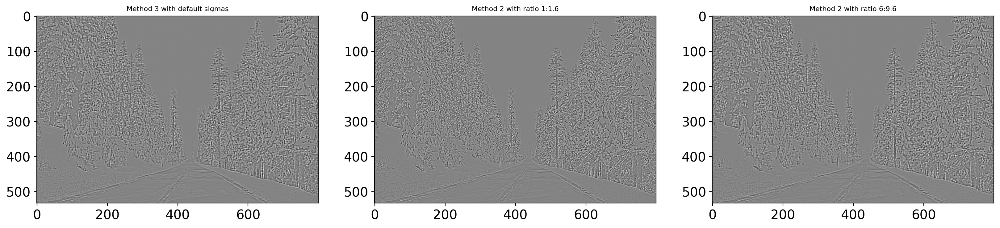

In [31]:
method3 = compute_laplacian_of_gaussian(image_array, method=3)

method3_1 = compute_laplacian_of_gaussian(image_array, method=3, sigma_1=1, sigma_2 = 1.6)

method3_2 = compute_laplacian_of_gaussian(image_array, method=3, sigma_1=6, sigma_2 = 9.6)

plt.subplots(1, 3, figsize=(20, 20))

plt.subplot(1, 3, 1)
plt.title('Method 3 with default sigmas')
plt.imshow(method3_2, cmap='gray')

plt.subplot(1, 3, 2)
plt.title('Method 2 with ratio 1:1.6')
plt.imshow(method3_1, cmap='gray')

plt.subplot(1, 3, 3)
plt.title('Method 2 with ratio 6:9.6')
plt.imshow(method3_2, cmap='gray')

plt.show()


##### <font color='yellow'>Answer:</font>

The best ratio between $\sigma_1$ and $\sigma_2$ to achieve the best approximation of the LoG is (in general) **1 : 1.6**; while this ratio may not achieve the best result with every single image, it represents a good trade-off between not calculating too many gaussians and still obtaining a significant output.

From what exposed at lecture, we know that blurring with a bigger-sigma gaussian suppresses high-frequencies info. Therefore, subtracting two gaussians (like in the DoG method) will preserve the information in the range of frequencies preserved in the blurred images. For this reason, the DoG acts as a spatial band-pass filter, with the desired band defined with the two different standard deviations.

Sources: 
- _"Difference of Gaussians" - Wikipedia_
- _"Computer Vision: Algorithms and Applications" by R. Szeliski, September 2021_



<a id="question-33"></a>
#### <font color='#FF0000'>Question 33 (2 points)</font>

What else is needed to improve the performance and isolate the road? You don't have to provide any specific parameter or algorithm. Propose a direction that would be interesting to explore and explain how you would approach it.

##### <font color='yellow'>Answer:</font>

To improve the performance and isolate the road in this specific image we could follow many different directions. One promising approach would be adding contrast enhancement as a pre-processing step before edge detection. Since the road is significantly darker than its surroundings in the image, applying a point operator like gamma correction could help in highlighting the intensity transition between the road and the snow/trees right by it.

More specifically, a gamma correction with γ < 1 would stretch the contrast in darker regions where the road lies, while compressing brighter areas containing snow. This would make the boundary between road and non-road regions more pronounced before applying edge detection.

We know that edge detection relies on identifying abrupt intensity variations in the image. By increasing the image's contrast in regions of interest, we can make these changes even more evident and easier to detect with our methods.

<a id="section-6"></a>
### **Section 6: Foreground-background separation**

Foreground-background separation is a crucial task in the field of computer vision, enabling applications such as object recognition, scene understanding, and image editing. The objective is to distinguish the main object (foreground) from the surrounding area (background) in an image. This process is essential when the foreground object needs to be isolated for further analysis or processing.

In this section, we will implement a simple unsupervised algorithm that leverages texture variations to segment the foreground object from the background. The assumption is that the foreground object has a distinct combination of textures compared to the background, which can be exploited for separation.

Gabor filters, known for their effectiveness in capturing texture information due to their frequency domain characteristics, will be used to analyze the texture differences within the image. By applying a collection of Gabor filters with varying scales and orientations—referred to as a *filter bank*—we can effectively distinguish between different texture patterns in the image.

In the example below, you can see how this process works. The **left** image shows the original input image. The **middle** image displays the foreground mask, which identifies the pixels that belong to the foreground object. The **right** image shows the result of applying the foreground mask to the input image, effectively isolating the foreground object from the background.

<img src="https://drive.google.com/thumbnail?id=1N4hExtMIiMxM03OK4iHKURTvSibccEwd&sz=w1000">

See the outline of the algorithm below:

---

**Foreground-Background Segmentation Algorithm**

---

**Input:** $x$ - input image

**Output:** $y$ - pixelwise labels

1.   Convert to grayscale if necessary.

>**if** $x$ is RGB **then**

>>$x$ $\leftarrow$ rgb2gray($x$)

>**end if**

2.   Create Gabor filterbank, $\mathcal{F}_{gabor}$, with varying $\sigma$, $\lambda$ and $\theta$.

3.   Filter $x$ with the filterbank. Store each output in $fmaps$.

4.   Compute the magnitude of the complex $fmaps$. Store the results in $fmags$.

>$fmags$ $\leftarrow$  $\vert fmaps \vert$

5.   Smooth $fmags$.

>$fmags$ $\leftarrow$  smooth($fmags$)

6.   Convert $fmags$ into data matrix, $f$.

>$f$ $\leftarrow$  reshape($fmags$)

7.   Cluster $f$ using kmeans into two sets.

>$y$ $\leftarrow$  kmeans($f$, 2)

---

<a id="question-33"></a>
#### <font color='#FF0000'>Question 33 (7 points)</font>

Please get familiar with the provided skeleton code below. You will need your implementation of the **create_gabor()** function. When you successfully implement all functions, the code should run without problems and produce a reasonable segmentation with the default parameters on **kobi.png**.

In [32]:
def load_image(image_id="kobi"):
    '''
    Load an image, resize it, and set the correct color representation.

    Args:
        image_id: ID of the image (default is "kobi")

    Returns:
        image: Loaded and processed image
    '''
    if image_id == 'clownfish':
        image = cv2.imread('./images/clownfish.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'flower':
        image = cv2.imread('./images/flower.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'kobi':
        image = cv2.imread('./images/kobi.png')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'landscape':
        image = cv2.imread('./images/landscape.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'polar_bear_hiding':
        image = cv2.imread('./images/polar_bear_hiding.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'robin':
        image = cv2.imread('./images/robin.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    elif image_id == 'swan':
        image = cv2.imread('./images/swan.jpg')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    else:
        raise ValueError('Image not available.')

    return image

In [33]:
def show_image(image, title="Kobi", colormap='gray'):
    '''
    Display an image in grayscale.

    Args:
        image: Image to be displayed
        title: Title for the image (default is "Kobi")
        colormap: Colormap used by matplotlib (default is 'gray')
    '''
    plt.figure()
    plt.title(title)
    plt.imshow(image, cmap=colormap)
    plt.axis("off")

In [34]:
### Foreground-Background Segmentation Algorithm
### Part 0 - Read Image and Convert to Grayscale

def preprocess_image(image_id="kobi"):
    '''
    Load an image, resize it, and convert it to grayscale if necessary.

    Args:
        image_id: ID of the image to load (default is "Kobi")

    Returns:
        grayscale_image: Grayscale image
    '''
    # Load the image
    image = load_image(image_id)
    show_image(image)

    # Check if the image is grayscale or RGB
    if image.ndim == 3:
        grayscale_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY).copy()
        show_image(grayscale_image)
    else:
        grayscale_image = image.copy()
    
    return grayscale_image

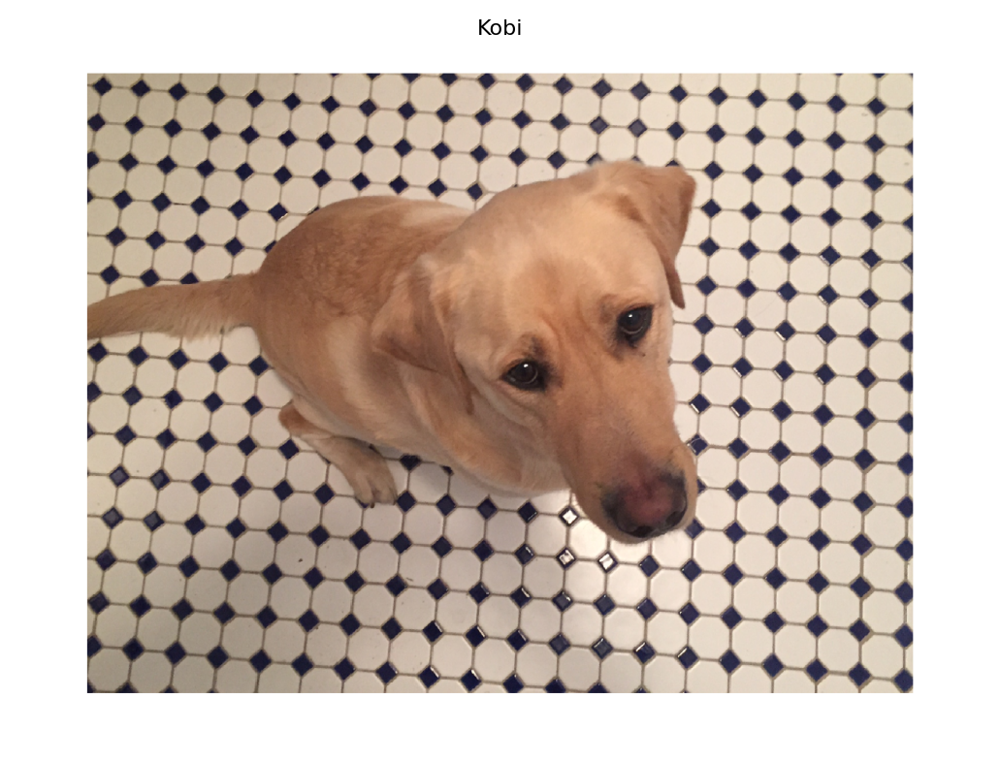

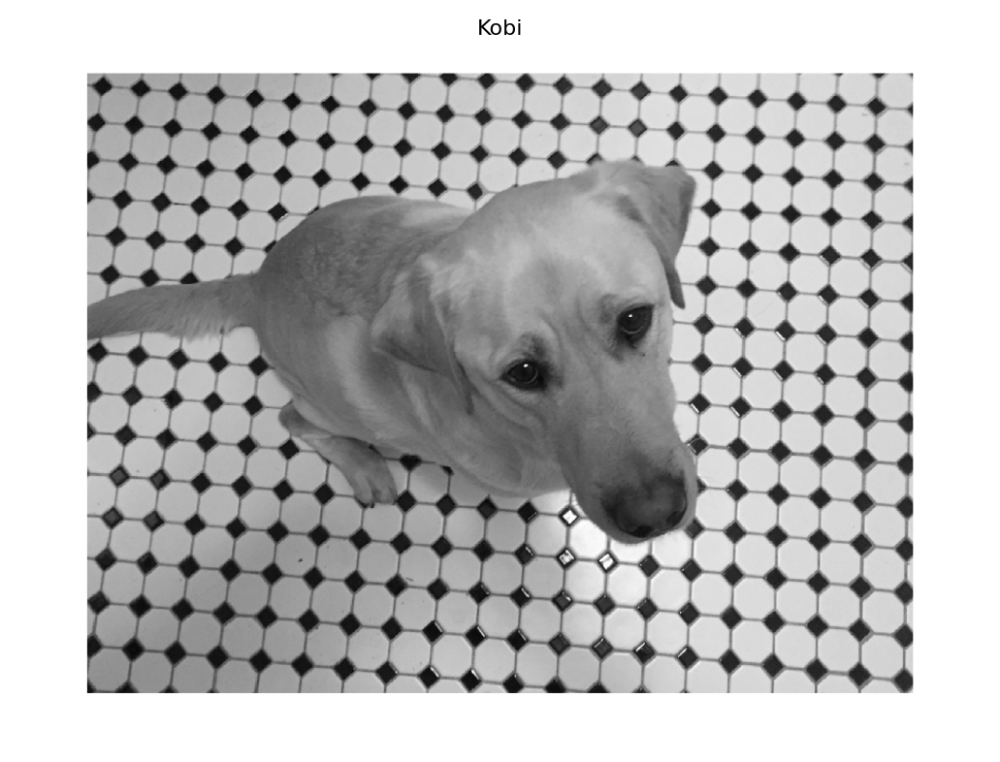

In [35]:
grayscale_image = preprocess_image(image_id="kobi")

In [36]:
def create_gabor_filter_bank(image):
    '''
    Create a Gabor filter bank with varying scales and orientations.

    Args:
        image: Grayscale input image

    Returns:
        gabor_filter_bank: A list of dictionaries containing Gabor filters and their parameters
    '''
    num_rows, num_cols = image.shape

    # Estimate the minimum and maximum wavelengths for the sinusoidal carriers
    lambda_min = 4 / np.sqrt(2)
    lambda_max = np.sqrt(np.abs(num_rows) ** 2 + np.abs(num_cols) ** 2)

    # Specify the carrier wavelengths
    n = np.floor(np.log2(lambda_max / lambda_min))
    lambdas = 2 ** np.arange(0, (n - 2) + 1) * lambda_min

    # Define the set of orientations for the Gaussian envelope (Thetas)
    delta_theta = np.pi / 4.0
    orientations = np.arange(0, np.pi + delta_theta, delta_theta)

    # Define the set of sigmas for the Gaussian envelope (spread of the Gaussian)
    sigmas = np.array([1, 2])

    gabor_filter_bank = []
    start_time = time.time()

    # Total number of features
    n_features = len(lambdas) * len(sigmas) * len(orientations)

    with tqdm(total=n_features) as pbar:

        # Generate Gabor filters for each combination of wavelength, sigma, and orientation
        for wavelength in lambdas:
            for sigma in sigmas:
                for theta in orientations:
                    # Filter parameter configuration
                    psi = 0
                    gamma = 0.5

                    # Create a Gabor filter with the specified parameters
                    filter_config = {}
                    filter_config["filter_pairs"] = create_gabor(sigma, theta, wavelength, psi, gamma)
                    filter_config["sigma"] = sigma
                    filter_config["wavelength"] = wavelength
                    filter_config["theta"] = theta
                    filter_config["psi"] = psi
                    filter_config["gamma"] = gamma

                    # Append the filter configuration to the filter bank
                    gabor_filter_bank.append(filter_config)

                    # Update the progress bar
                    pbar.update(1)

    creation_time = time.time() - start_time
    
    # Print details about the created filter bank
    print(f'Total number of filters: {len(gabor_filter_bank)}')
    print(f'Number of scales (sigma): {len(sigmas)}')
    print(f'Number of orientations (theta): {len(orientations)}')
    print(f'Number of carriers (lambda): {len(lambdas)}')
    print(f'\nFilter bank created in {creation_time} seconds.')

    return gabor_filter_bank

In [37]:
gabor_filter_bank = create_gabor_filter_bank(grayscale_image)

100%|██████████| 80/80 [00:00<00:00, 6717.07it/s]

Total number of filters: 80
Number of scales (sigma): 2
Number of orientations (theta): 5
Number of carriers (lambda): 8

Filter bank created in 0.017125844955444336 seconds.


In [38]:
### Foreground-Background segmentation algoritm
### Part 2 - gabor features fMaps and fMags

def extract_gabor_features(image, gabor_filter_bank, visualize=False):
    '''
    Filter images using the Gabor filter bank with quadrature pairs (real and imaginary parts).

    Args:
        image: Grayscale input image
        gabor_filter_bank: A list of dictionaries containing Gabor filters and their parameters
        visualize: Flag to visualize filter responses (default is False)

    Returns:
        feature_magnitudes: List of magnitude responses for each Gabor filter
    '''
    feature_maps = []

    with tqdm(total=len(gabor_filter_bank)) as pbar:

        for gabor_filter in gabor_filter_bank:
            # Filter the image with the real and imaginary parts of the Gabor filter

            real_output = scipy.signal.convolve(image, gabor_filter["filter_pairs"][:,:,0], mode='same').copy()
            imaginary_output = scipy.signal.convolve(image, gabor_filter["filter_pairs"][:,:,1], mode='same').copy()

            # Append the real and imaginary parts to the list of feature maps
            feature_maps.append(np.stack((real_output, imaginary_output), 2))

            # Update the progress bar
            pbar.update(1)

            # Visualize the filter responses if requested
            if visualize:
                fig = plt.figure()
                ax = fig.add_subplot(1, 2, 1)
                ax.imshow(real_output, cmap='gray')
                ax.set_title(f'Real Part, λ={gabor_filter["wavelength"]:.4f}, θ={gabor_filter["theta"]:.4f}, σ={gabor_filter["sigma"]:.4f}')
                ax.axis("off")

                ax = fig.add_subplot(1, 2, 2)
                ax.imshow(imaginary_output, cmap='gray')
                ax.set_title(f'Imaginary Part, λ={gabor_filter["wavelength"]:.4f}, θ={gabor_filter["theta"]:.4f}, σ={gabor_filter["sigma"]:.4f}')
                ax.axis("off")
                plt.show()

    # Compute the magnitude of the output responses
    feature_magnitudes = []

    with tqdm(total=len(feature_maps)) as pbar:
    
        for i, feature_map in enumerate(feature_maps):

            # Compute the magnitude of the feature map
            magnitude = np.sqrt(feature_map[:,:,0]**2 + feature_map[:,:,1]**2)
            feature_magnitudes.append(magnitude)

            # Update the progress bar
            pbar.update(1)

            # Visualize the magnitude response if requested
            if visualize:
                plt.figure()
                plt.imshow(magnitude.astype(np.uint8), cmap='gray')
                plt.title(f'Magnitude, λ={gabor_filter_bank[i]["wavelength"]:.4f}, θ={gabor_filter_bank[i]["theta"]:.4f}, σ={gabor_filter_bank[i]["sigma"]:.4f}')
                plt.axis("off")
                plt.show()

    print(f'Created {len(feature_magnitudes)} features for each pixel')
    return feature_magnitudes

In [39]:
feature_magnitudes = extract_gabor_features(grayscale_image, gabor_filter_bank)

100%|██████████| 80/80 [00:01<00:00, 43.69it/s]


Created 80 features for each pixel


In [40]:
### Foreground-Background segmentation algoritm
### Part 3 - cluster features in two sets

def cluster_features(image, feature_magnitudes, apply_smoothing=True):
    '''
    Cluster pixels based on their Gabor feature magnitudes.

    Hint: To standardize the features, you can use the following web page: https://www.analyticsvidhya.com/blog/2020/04/feature-scaling-machine-learning-normalization-standardization/

    Args:
        image: Grayscale input image
        feature_magnitudes: List of magnitude responses for each Gabor filter
        apply_smoothing: Flag to apply Gaussian smoothing (default is True)

    Returns:
        pixel_labels: Cluster labels for each pixel
    '''
    num_rows, num_cols = image.shape
    features = np.zeros(shape=(num_rows, num_cols, len(feature_magnitudes)))

    if apply_smoothing:
        # Apply Gaussian smoothing to each feature magnitude
        gaussian_kernel = gaussian_kernel_2D(sigma_x=2.0, sigma_y=2.0, kernel_size=3)

        for i, feature_magnitude in enumerate(feature_magnitudes):
            features[:, :, i] = scipy.signal.convolve(feature_magnitude, gaussian_kernel, mode='same')
    else:
        # Directly insert magnitude images into the features matrix
        for i, feature_magnitude in enumerate(feature_magnitudes):
            features[:, :, i] = feature_magnitude

    # Reshape the features matrix to prepare for clustering
    features = np.reshape(features, newshape=(num_rows * num_cols, -1))

    # Standardize the features   
    standardized_features = (features - np.mean(features)) / np.std(features)

    start_time = time.time()

    # Apply k-means clustering
    kmeans = KMeans(n_clusters=2, random_state=42)
    pixel_labels = kmeans.fit_predict(standardized_features)

    print(f'Clustering completed in {time.time() - start_time} seconds.')

    return pixel_labels

In [41]:
pixel_labels = cluster_features(grayscale_image, feature_magnitudes, apply_smoothing=True)

Clustering completed in 7.9529945850372314 seconds.


In [42]:
### Foreground-Background segmentation algorithm
### Part 4 - Visualise result

def visualize_clustering_results(image, pixel_labels):
    '''
    Visualize the clustering results and segmentation.

    Args:
        image: Grayscale input image
        pixel_labels: Cluster labels for each pixel

    Returns:
        None
    '''
    num_rows, num_cols = image.shape
    pixel_labels = np.reshape(pixel_labels, newshape=(num_rows, num_cols))

    # Visualize pixel clusters
    plt.figure()
    plt.title('Pixel Clusters')
    plt.imshow(pixel_labels)
    plt.axis("off")
    plt.show()

    # Use pixel labels to visualize segmentation
    segmented_image1 = np.zeros_like(image)
    segmented_image2 = np.zeros_like(image)

    # YOUR CODE HERE
    binary_mask = pixel_labels == 0 # Check for the value of your labels in pixel_labels (could be 1 or 2 instead of 0)

    segmented_image1[binary_mask] = image[binary_mask]
    segmented_image2[~binary_mask] = image[~binary_mask]

    plt.figure()
    plt.title('Montage')
    plt.imshow(segmented_image1, cmap='gray', interpolation='none')
    plt.imshow(segmented_image2, cmap='jet', interpolation='none', alpha=0.7)
    plt.axis("off")
    plt.show()

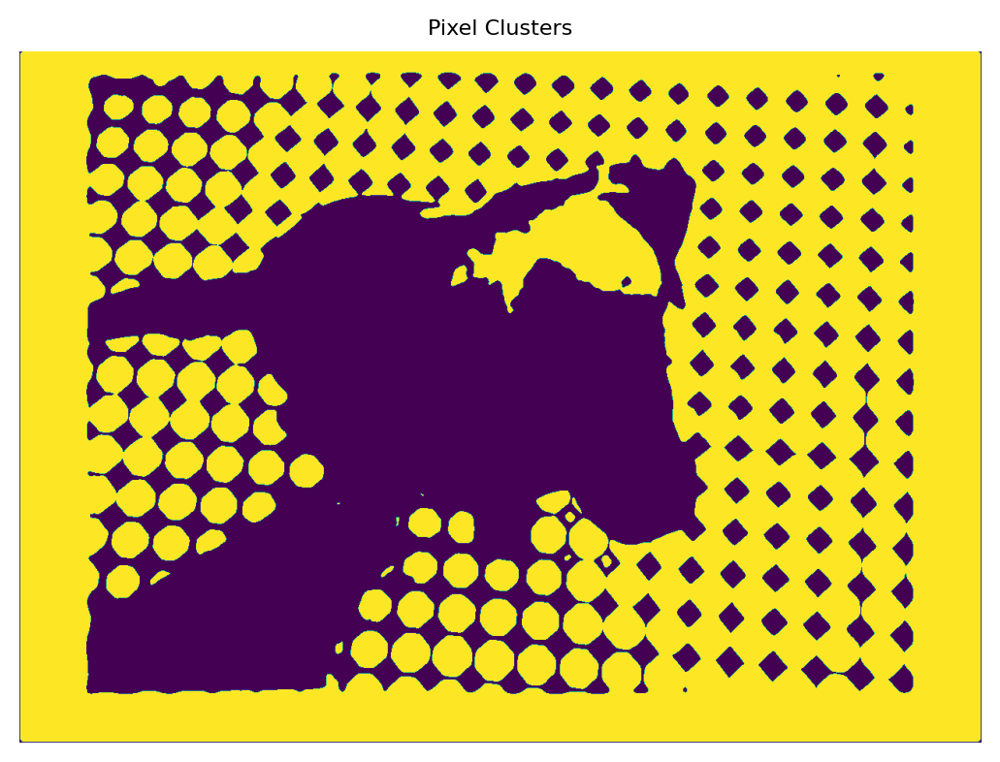

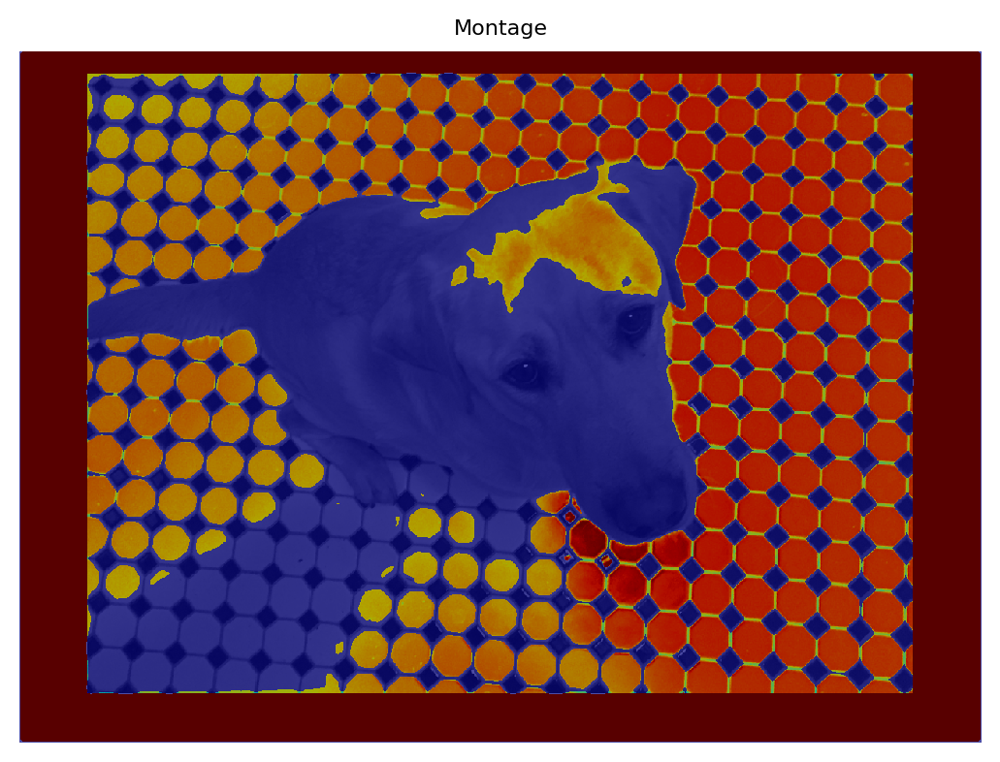

In [43]:
# Visualize the results
visualize_clustering_results(grayscale_image, pixel_labels)

<a id="question-34"></a>
#### <font color='#FF0000'>Question 34 (7 points)</font>

Implement the `foreground_background_separation()` function using Gabor filters. Complete the function provided and experiment with different images (`clownfish`, `flower`, `kobi`, `polar_bear_hiding`, `robin` **and** `swan`) using the default parameters.

Make sure to visualize the results using four subplots: the original image, the pixel representation projected onto the first principal component, the pixel clusters, and the montage showing segmentation. 

After visualizing the results, observe how the `sigmas` and `orientations` parameters influence the foreground-background separation. Describe your observations, focusing on the effectiveness of the separation and any patterns or trends you notice.

In [44]:
def foreground_background_separation(image, sigmas, orientations, apply_smoothing=True):
    '''
    Perform foreground-background segmentation using Gabor filters.

    Args:
        image: Grayscale input image
        sigmas: List of sigmas for the Gaussian envelope
        orientations: List of orientations for the Gabor filters
        apply_smoothing: Flag to apply Gaussian smoothing to magnitude images (default is True)

    Returns:
        None
    '''
    num_rows, num_cols = image.shape

    lambda_min = 4 / np.sqrt(2)
    lambda_max = np.sqrt(np.abs(num_rows) ** 2 + np.abs(num_cols) ** 2)
    n = np.floor(np.log2(lambda_max / lambda_min))
    lambdas = 2 ** np.arange(0, (n - 2) + 1) * lambda_min

    gabor_filter_bank = []

    for wavelength in lambdas:
        for sigma in sigmas:
            for theta in orientations:
                psi = 0
                gamma = 0.5

                filter_config = {}
                filter_config["filter_pairs"] = create_gabor(sigma, theta, wavelength, psi, gamma)
                filter_config["sigma"] = sigma
                filter_config["wavelength"] = wavelength
                filter_config["theta"] = theta
                filter_config["psi"] = psi
                filter_config["gamma"] = gamma

                gabor_filter_bank.append(filter_config)

    feature_maps = []

    for gabor_filter in gabor_filter_bank:
        real_output = scipy.signal.convolve(image, gabor_filter["filter_pairs"][:,:,0], mode='same').copy()
        imaginary_output = scipy.signal.convolve(image, gabor_filter["filter_pairs"][:,:,1], mode='same').copy()
        feature_maps.append(np.stack((real_output, imaginary_output), 2))

    feature_magnitudes = []

    for i, feature_map in enumerate(feature_maps):
        magnitude = np.sqrt(feature_map[:,:,0]**2 + feature_map[:,:,1]**2)
        feature_magnitudes.append(magnitude)

    features = np.zeros(shape=(num_rows, num_cols, len(feature_magnitudes)))

    if apply_smoothing:
        gaussian_kernel = gaussian_kernel_2D(sigma_x=2, sigma_y=2, kernel_size=3)

        for i, feature_magnitude in enumerate(feature_magnitudes):
            features[:, :, i] = scipy.signal.convolve(feature_magnitude, gaussian_kernel, mode='same')
    else:
        for i, feature_magnitude in enumerate(feature_magnitudes):
            features[:, :, i] = feature_magnitude

    features = np.reshape(features, newshape=(num_rows * num_cols, -1))
    standardized_features = (features - np.mean(features)) / np.std(features)

    kmeans = KMeans(n_clusters=2, random_state=42, n_init=10, max_iter=100)
    pixel_labels = kmeans.fit_predict(standardized_features).reshape(num_rows, num_cols)

    segmented_image1 = np.zeros_like(image)
    segmented_image2 = np.zeros_like(image)
    binary_mask = pixel_labels == 0 # Check for the value of your labels in pixel_labels (could be 1 or 2 instead of 0)
    segmented_image1[binary_mask] = image[binary_mask]
    segmented_image2[~binary_mask] = image[~binary_mask]

    # === Step 5: PCA projection of features for visualization ===
    pca = PCA(n_components=1)
    pca_results = pca.fit_transform(np.mean(feature_magnitudes, axis=0).reshape(-1, 1))
    first_pc = pca_results[:, 0].reshape((num_rows, num_cols))
    first_pc = (first_pc - np.min(first_pc)) / (np.max(first_pc) - np.min(first_pc))

    # === Step 6: Visualization ===
    plt.figure(figsize=(18,4))

    # 1. Original image
    plt.subplot(1,4,1)
    plt.imshow(image, cmap="gray")
    plt.title("Original")
    plt.axis("off")

    # 2. First principal component
    plt.subplot(1,4,2)
    plt.imshow(first_pc, cmap="gray")
    plt.title("First Principal Component")
    plt.axis("off")

    # 3. Pixel clusters
    plt.subplot(1,4,3)
    plt.imshow(pixel_labels, cmap="jet")
    plt.title("Pixel Clusters")
    plt.axis("off")

    # 4. Montage
    plt.subplot(1,4,4)
    plt.title('Montage')
    plt.imshow(segmented_image1, cmap='gray', interpolation='none')
    plt.imshow(segmented_image2, cmap='jet', interpolation='none', alpha=0.7)
    plt.axis("off")

    plt.tight_layout()
    plt.show()

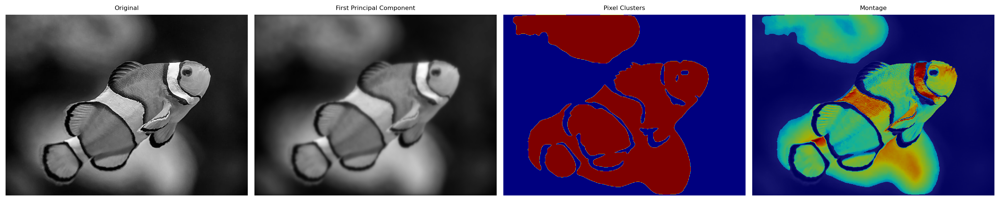

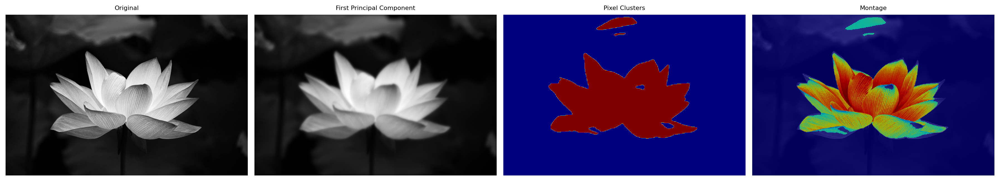

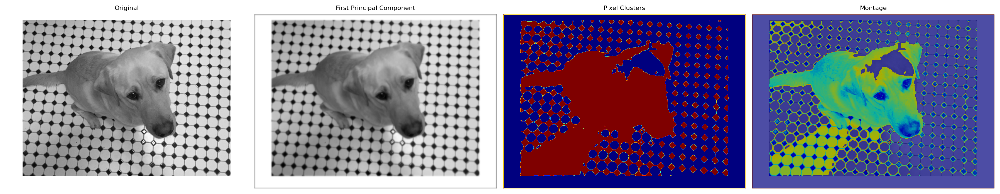

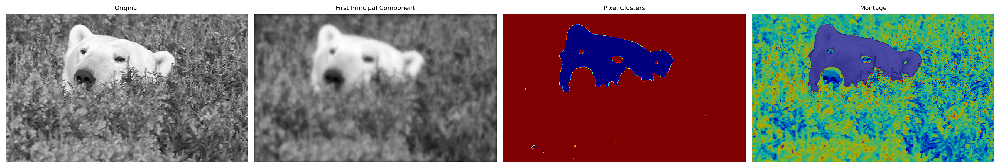

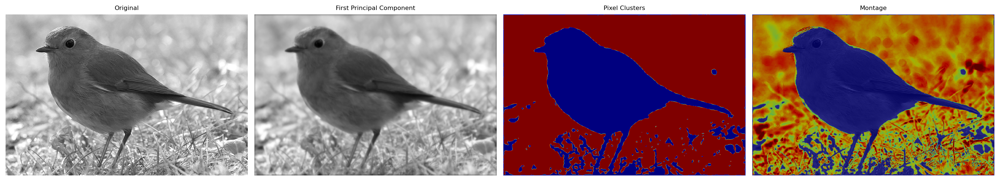

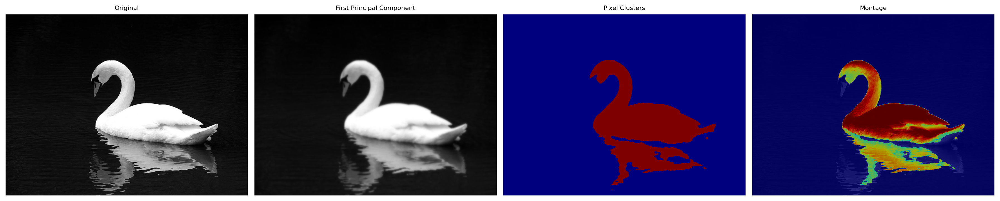

In [45]:
# Control settings
delta_theta = 2 * np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1.0, 2.0])
apply_smoothing = True

image_names = [
    "clownfish",
    "flower",
    "kobi",
    "polar_bear_hiding",
    "robin",
    "swan"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, apply_smoothing)

##### <font color='yellow'>Answer:</font>

In most cases, the foreground and background are well separated. Minor errors occur in the Kobi, Fish, and Swan images, where portions of the background are misclassified as foreground. This typically arises when background regions have pixel intensities or textures similar to the foreground, making them harder to distinguish. The choice of sigma plays a key role: smaller sigma values allow Gabor filters to capture fine-grained textures and subtle edge details, while larger sigmas emphasize broader structural features and object contours by blurring the image. Similarly, using multiple orientations ensures that edges in all directions are detected, improving the robustness of foreground extraction, especially for complex or irregularly shaped objects. Combining responses from filters at multiple scales and orientations enhances the algorithm’s ability to suppress background noise while consistently highlighting the main figure, resulting in more accurate foreground/background separation.

<a id="question-35"></a>
#### <font color='#FF0000'>Question 35 (4 points)</font>

Experiment with different `sigma` and `theta` settings for the `foreground_background_separation()` function until you achieve reasonable outputs. For each input image, report the parameter settings that work best and provide an explanation for why these settings are effective. 

##### <font color='yellow'>Answer:</font>

For the Clownfish figure, the best results are obtained with high values of sigma. For example, with sigma = [1, 1], the algorithm mistakenly detects the stripes of the clownfish as part of the background rather than the foreground. Orientation does not seem to have a strong influence on the results. A good combination of parameters is sigma = [7, 7] and orientations = [0, 0.78539816, 1.57079633, 2.35619449, 3.14159265, 3.92699082, 4.71238898, 5.49778714].

For the Flower figure, the best sigma values seem to be [10, 5], as they allow the removal of background regions previously misclassified as foreground, with the drawback of slightly reducing sensitivity on the lowest petals. One good orientation set is [0, 0.26179939, 0.52359878, 1.04719755, 1.57079633, 3.14159265].

For the Kobi image, we were not able to find a combination of parameters that improves over the standard ones. Testing showed that increasing the sigmas worsened the separation, and changing the rotations had a similar negative effect.

For the Polar Bear, we set high sigmas [10, 10] and the orientation set [0, 0.26179939, 0.52359878, 1.04719755, 1.57079633, 3.14159265]. A wide range of orientations ensures that the edges of the bear are well segmented, while the high sigmas separate the bear from the finer details in the grass. However, we were still unable to include the bear’s nose in the foreground.

For the Robin, as with the other images, higher sigma values help reduce background noise and better shape the figure in the foreground. Good parameters are sigma = [5.0, 5.0] and orientations = [0, 0.26179939, 0.52359878, 1.04719755, 1.57079633, 3.14159265].

For the Swan, good parameters are sigma = [3.0, 3.0] and orientations = [0, 0.78539816, 1.57079633]. We were not able to find a combination of parameters that includes the swan’s beak, and its reflection remains present in all tested combinations.

<a id="question-36"></a>
#### <font color='#FF0000'>Question 36 (4 points)</font>

After achieving decent separation on all test images, run the script again using the corresponding parameters, but this time set `apply_smoothing = False`. 

Describe what you observe in the output when smoothing is not applied to the magnitude images. Explain why these changes occur and discuss the reasoning behind the smoothing step.

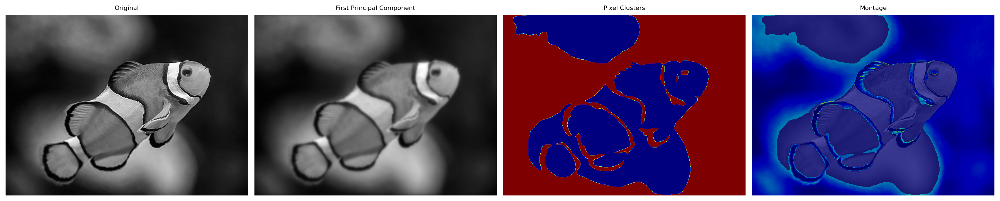

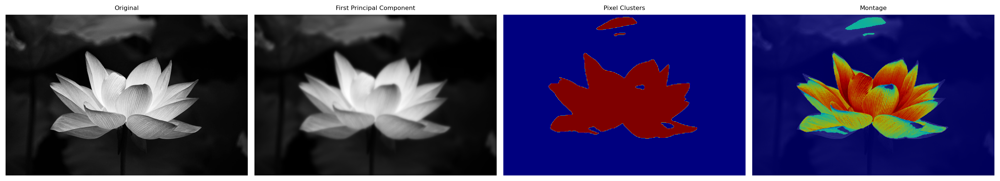

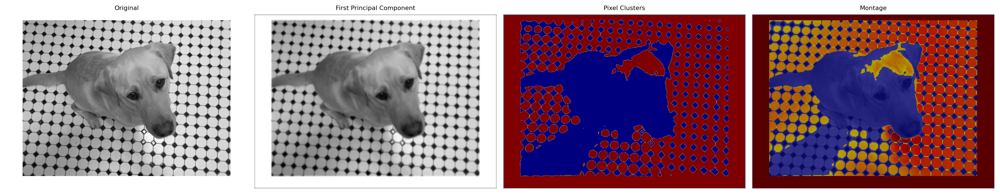

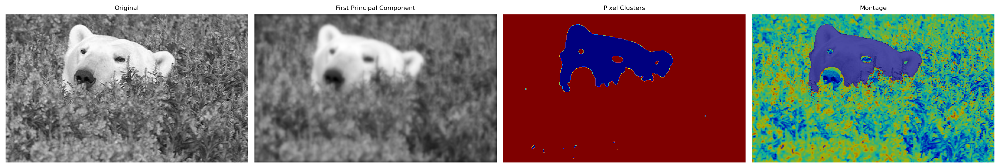

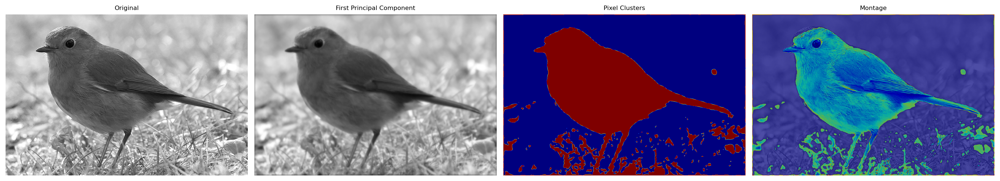

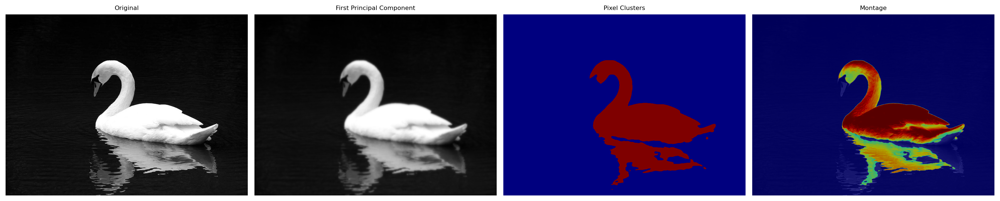

In [46]:
delta_theta = 2 * np.pi / 8  # Step size for orientations
orientations = np.arange(0, np.pi + delta_theta, delta_theta)
sigmas = np.array([1.0, 2.0])

image_names = [
    "clownfish",
    "flower",
    "kobi",
    "polar_bear_hiding",
    "robin",
    "swan"
]

# Loop through each image, load it, and apply foreground-background separation
for image_name in image_names:
    # Load the image
    image = load_image(image_name)
    
    # Convert the image to grayscale
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    # Perform foreground-background separation
    foreground_background_separation(image, sigmas, orientations, False)

##### <font color='yellow'>Answer:</font>

When avoiding the smoothing phase, the segmentation quality noticeably decreases, with more small groups of pixels incorrectly marked as foreground. Without smoothing, fine details in the background such as the small individual structures in the clownfish image can be mistakenly detected as background because their magnitude responses stand out from the surrounding area. Smoothing is applied to achieve a more uniform texture in the magnitude images, reducing noise. By averaging out the small fluctuations the algorithm can focus on the true patterns of the actual foreground, producing a cleaner result.

<a id="section-x"></a>
### **Section X: Individual Contribution Report *(Mandatory)***

Because we want each student to contribute fairly to the submitted work, we ask you to fill out the textcells below. Write down your contribution to each of the assignment components in percentages. Naturally, percentages for one particular component should add up to 100% (e.g. 30% - 30% - 40%). No further explanation has to be given.

| Name | Contribution on Research | Contribution on Programming | Contribution on Writing |
| -------- | ------- | ------- | ------- |
| David Van Batenburg | 25% | 25% | 25% |
| Samuele Punzo | 25% | 25% | 25% |
| Edoardo Vergnano | 25% | 25% | 25% |
| Seyedeh Zahra Ahmadi | 25% | 25% | 25% |

### - End of Notebook -